<a href="https://colab.research.google.com/github/MathBioCU/WSINDy4Weather/blob/main/barotropic_forecast.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Barotropic Forecast

### Forecast Simulation

PyQG installation

In [ ]:
# First, have to install condacolab
!pip install -q condacolab
import condacolab
condacolab.install()

# Kernel restarts...

⏬ Downloading https://github.com/conda-forge/miniforge/releases/download/23.11.0-0/Mambaforge-23.11.0-0-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:30
🔁 Restarting kernel...


In [ ]:
import condacolab
condacolab.check()

✨🍰✨ Everything looks OK!


In [ ]:
# Import dependencies
import numpy as np
import cython
import matplotlib.pyplot as plt
import xarray

In [ ]:
# Now, install pyqg
!conda install -c conda-forge pyqg

import pyqg
import pyfftw

In [ ]:
# Access your Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Change directories
%cd /content/drive/My Drive/WSINDy/PyQuasiGeostrophic

Mounted at /content/drive
/content/drive/My Drive/WSINDy/PyQuasiGeostrophic


Import previous results

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import scipy

# File path for ground truth data
file_path = '/content/drive/My Drive/WSINDy'
data_path_true = file_path + '/PyQuasiGeostrophic/ground_truth.csv'

# File path for predicted data
data_path_pred = file_path + '/PyQuasiGeostrophic/prediction.csv'

# Read in CSV data
W_true = np.loadtxt(data_path_true, delimiter=',')
W_pred = np.loadtxt(data_path_pred, delimiter=',')

# Convert to torch tensor
W_true = torch.tensor(W_true)
W_pred = torch.tensor(W_pred)

# Reshape into a Nx x Ny x Nt tensor
(Nx, Ny) = (256, 256) # Barotropic
W_true = W_true.view(Nx, Ny, -1)
W_pred = W_pred.view(Nx, Ny, -1)

# Transpose the data
W_true = W_true.transpose(0,1)
W_pred = W_pred.transpose(0,1)

print(f"Imported tensor with shape {W_true.shape, W_pred.shape}")

# Clear other variables
del Nx, Ny
del file_path, data_path_true, data_path_pred

Imported tensor with shape (torch.Size([256, 256, 80]), torch.Size([256, 256, 80]))


Run simulation

In [ ]:
w = 1.0037377421367646 - 1.
w

0.003737742136764588

In [ ]:
# class wsindy_param(QParameterization):
#     def __init__(self, constant=0):
#         r"""
#         Parameters
#         ----------
#         constant : number
#             Adds + constant*advection(q) to q_t. Consant defaults to 0
#         """
#         self.constant = constant

#     def __call__(self, m):
#         r"""
#         Parameters
#         ----------
#         m : Model
#             The model for which we are evaluating the parameterization.
#         """
#         qh = m.fft(m.q) # "q hat"
#         qx = m.ifft(qh * m.ik) # Partial wrt x
#         qy = m.ifft(qh * m.il) # Partial wrt y
#         advect = (m.u)*(qx) + (mu.v)*(qy)
#         dq = -(self.constant)*advect
#         return dq

#     def __repr__(self):
#         return f"wsindy(constant={self.constant})"

wsindy_param = lambda m: -w*(m.u*(m.ifft(m.fft(m.q)*m.ik)) + m.v*(m.ifft(m.fft(m.q)*m.il)))

In [ ]:
# Create the model objects

# Ground true model
m1 = pyqg.BTModel(L=2.*np.pi, nx=256, beta=0., H=1., rek=0.,
                 rd=None, tmax=10, dt=0.001, taveint=1, ntd=4)

# Learned model
m2 = pyqg.BTModel(L=2.*np.pi, nx=256, beta=0., H=1., rek=0.,
                 rd=None, tmax=10, dt=0.001, taveint=1, ntd=4,
                 q_parameterization=wsindy_param)

# ntd = number of threads
# rek = linear drag
# taveint = time interval for getting diagnostics
# H = "thickness" (?)

INFO:  Logger initialized
INFO:  Logger initialized


In [ ]:
W.shape

torch.Size([256, 256, 160])

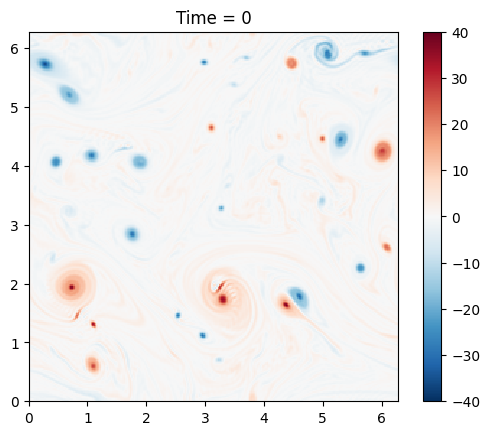

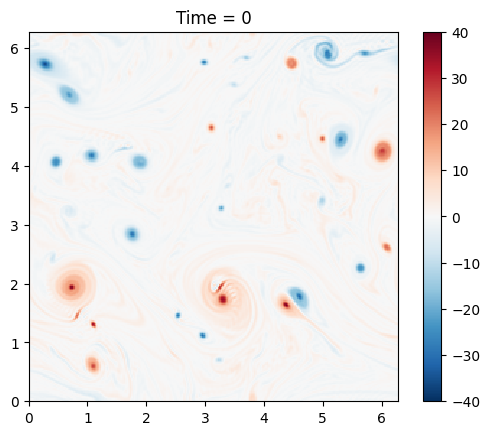

In [ ]:
# Set initial condition (last snapshot)
# qi... (numpy.ndarray, (1, 256, 256))
qi = W[:,:,-1].transpose(0,1).unsqueeze(0).numpy()
m1.set_q(qi)
m2.set_q(qi)

# Plot the initial condition
def plot_q(m, qmax=40):
  fig, ax = plt.subplots()
  pc = ax.pcolormesh(m.x, m.y, m.q.squeeze(), cmap='RdBu_r')
  pc.set_clim([-qmax, qmax])
  ax.set_xlim([0, 2*np.pi])
  ax.set_ylim([0, 2*np.pi]);
  ax.set_aspect(1)
  plt.colorbar(pc)
  plt.title('Time = %g' % m.t)
  plt.show()

plot_q(m1)
plot_q(m2)

Printing ground truth model...


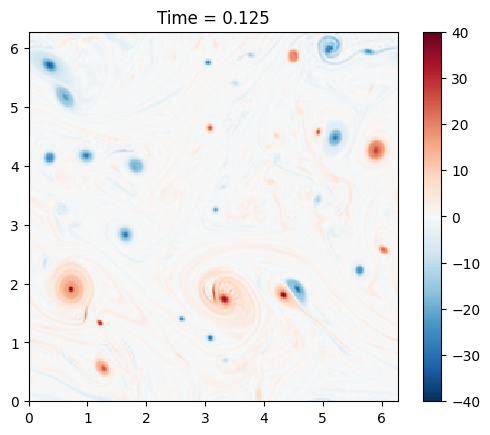

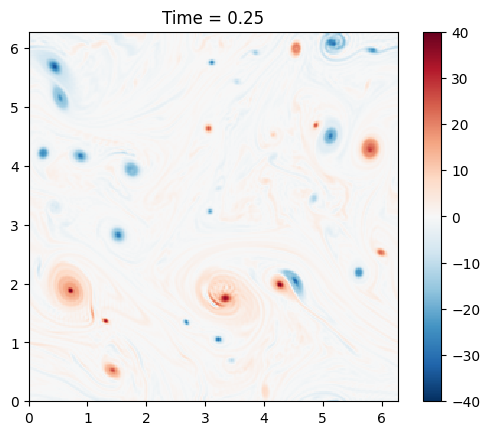

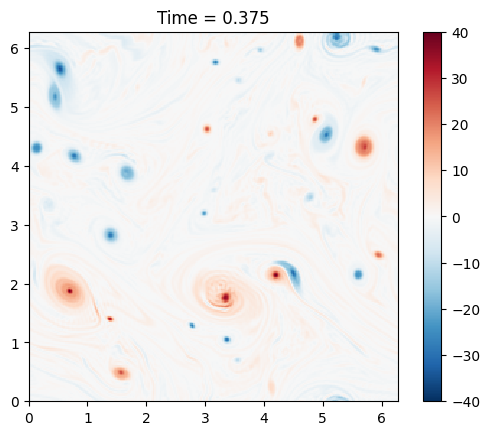

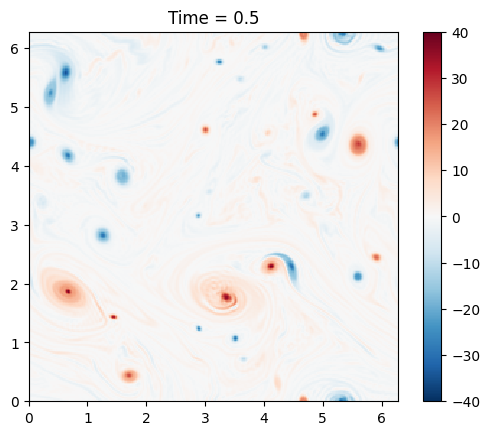

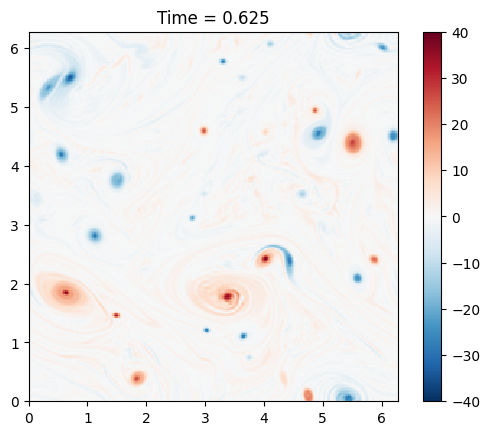

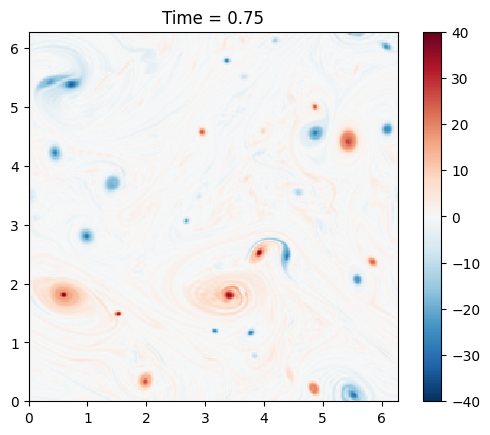

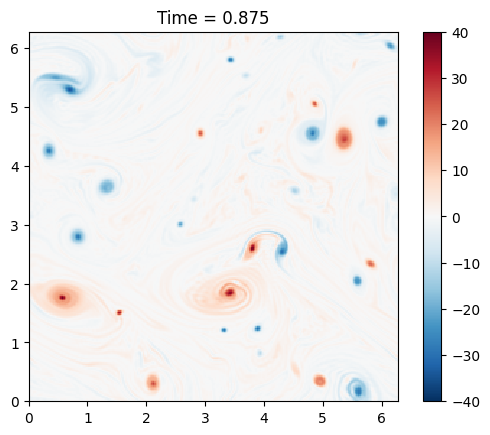

INFO: Step: 1000, Time: 1.00e+00, KE: 4.93e-01, CFL: 0.088


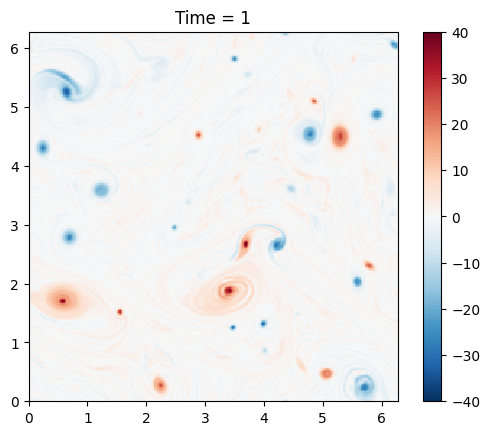

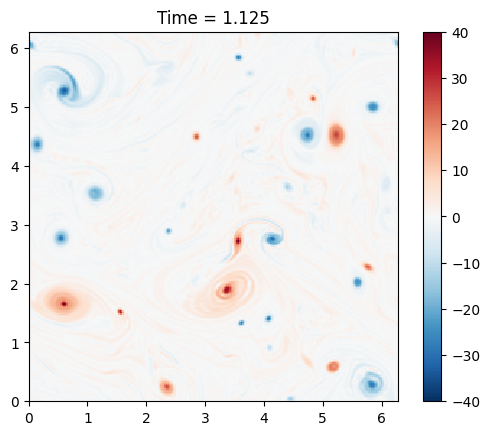

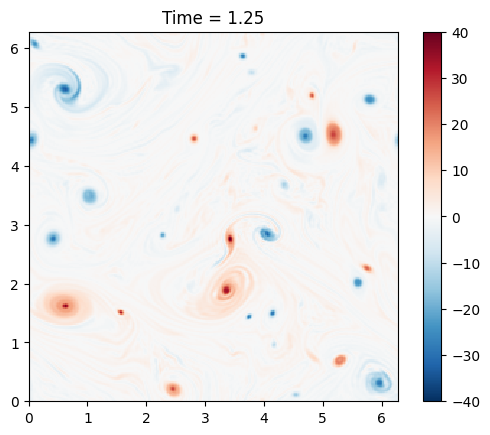

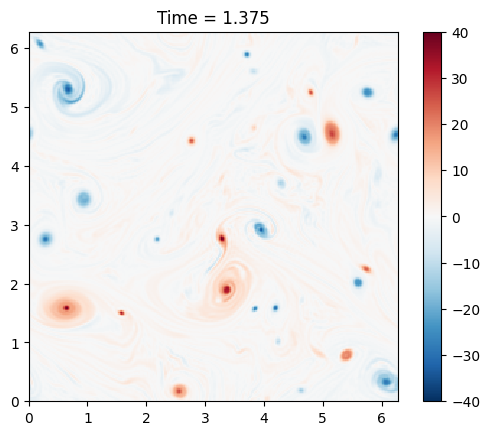

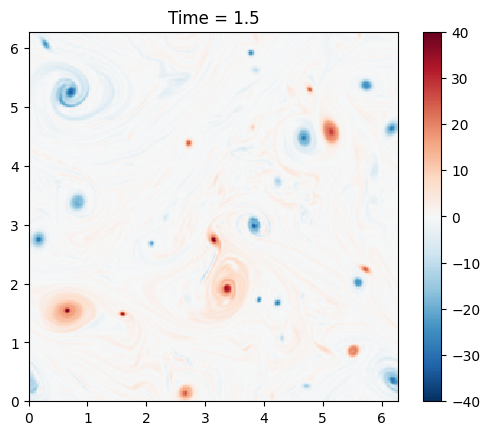

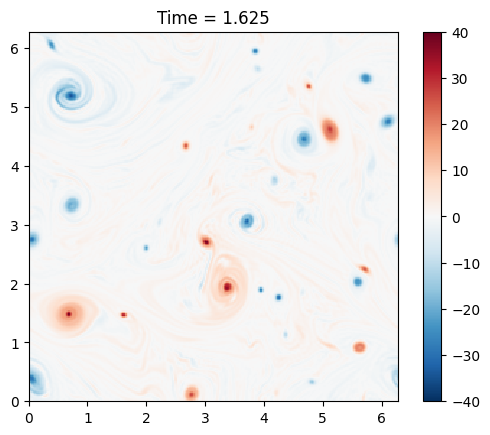

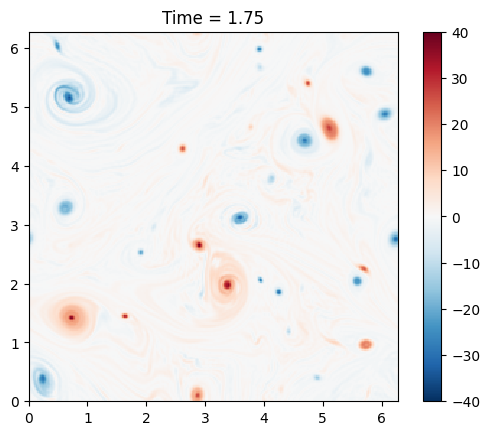

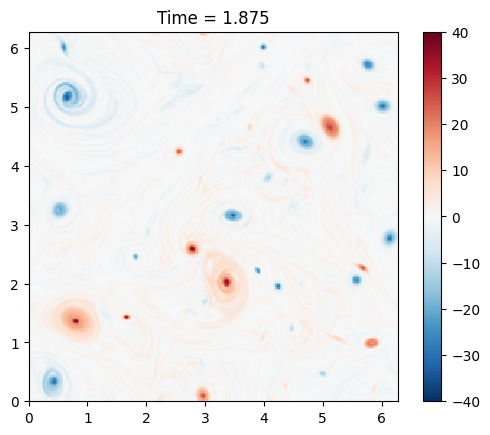

INFO: Step: 2000, Time: 2.00e+00, KE: 4.93e-01, CFL: 0.109


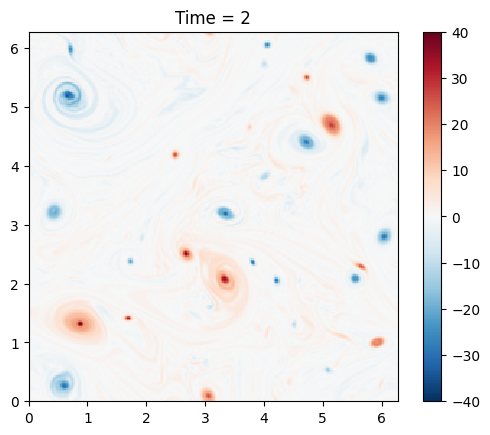

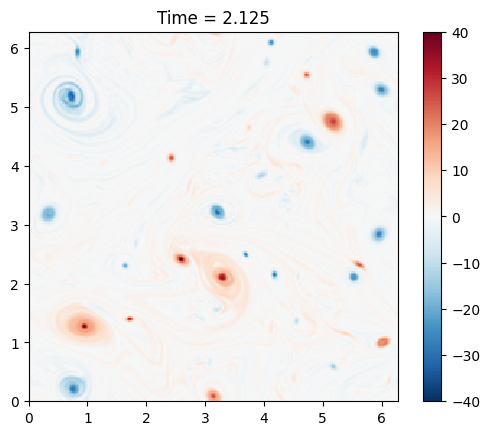

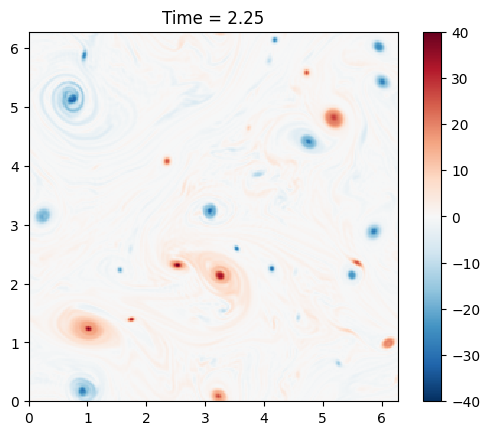

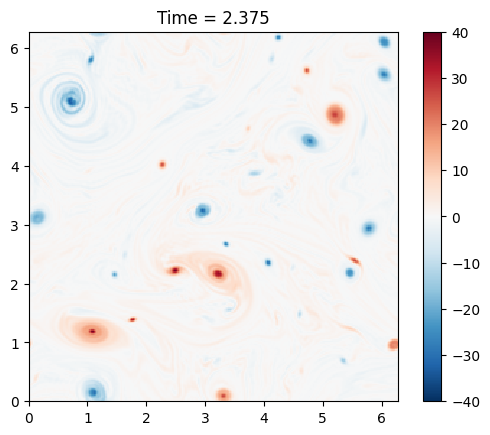

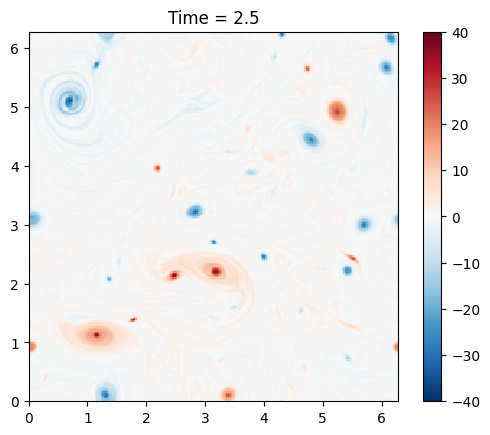

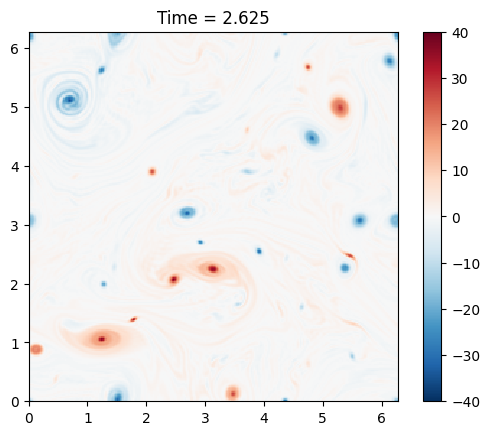

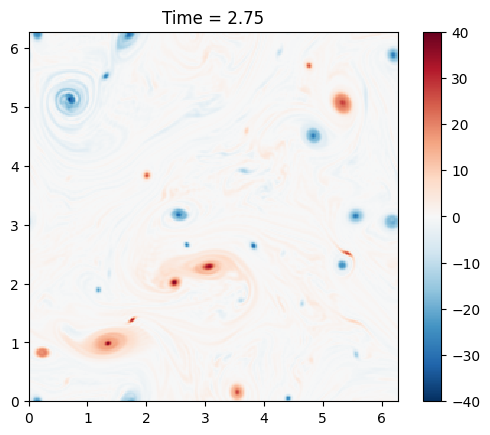

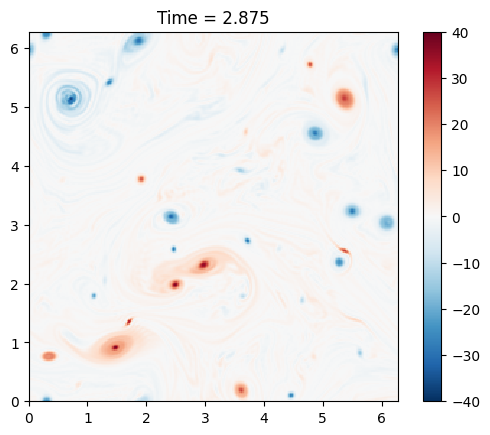

INFO: Step: 3000, Time: 3.00e+00, KE: 4.93e-01, CFL: 0.118


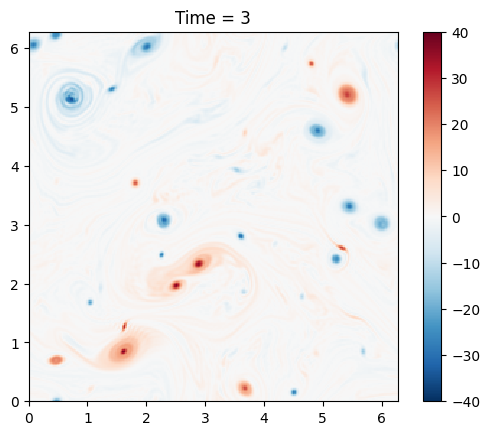

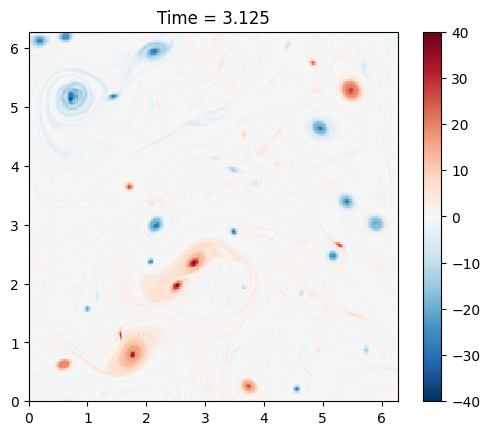

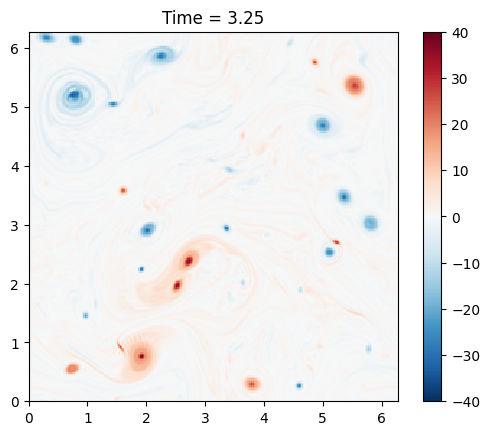

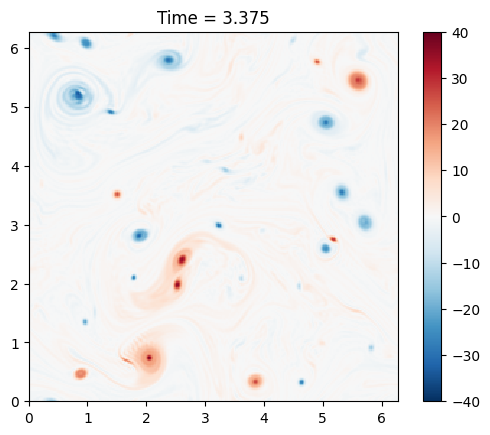

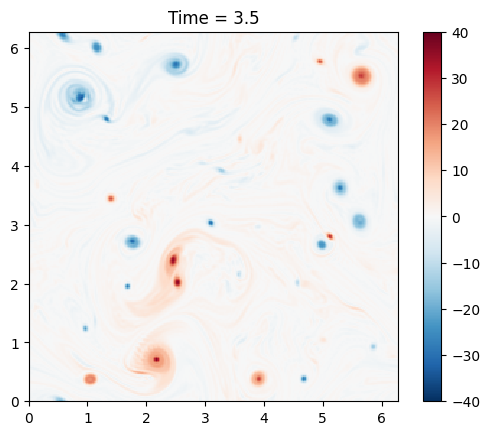

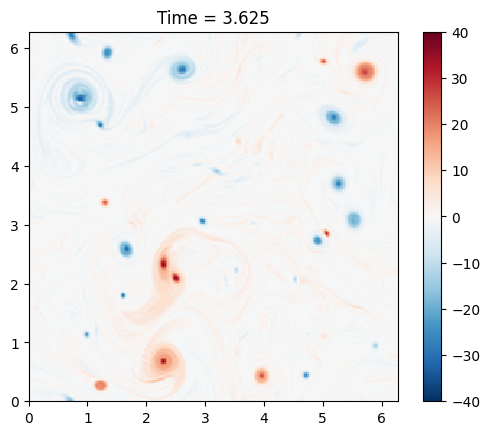

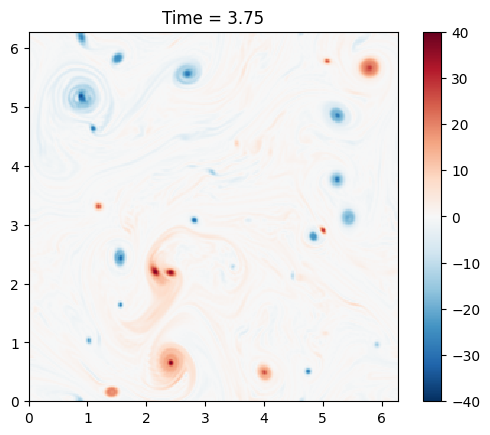

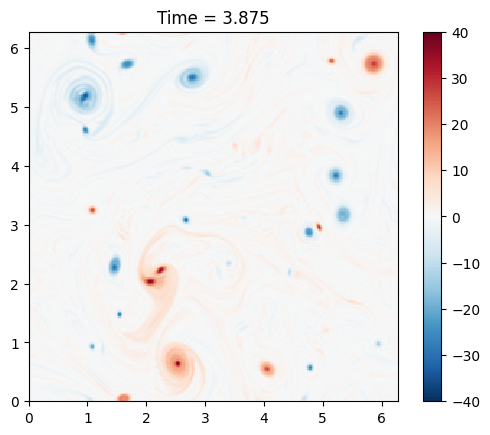

INFO: Step: 4000, Time: 4.00e+00, KE: 4.93e-01, CFL: 0.101


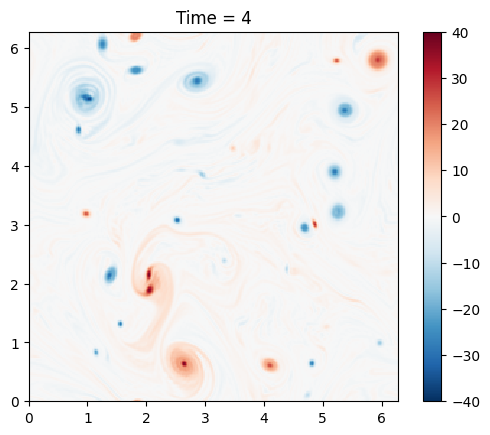

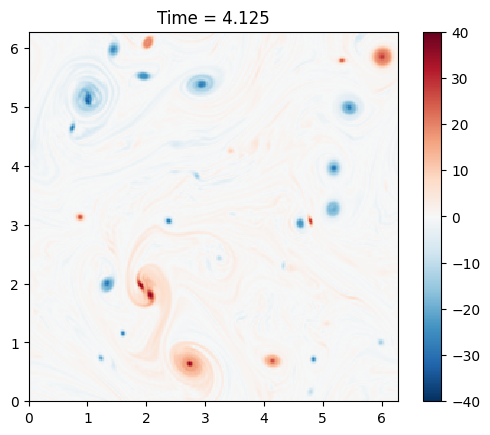

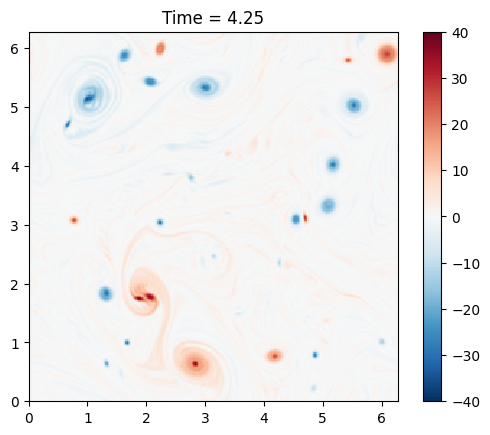

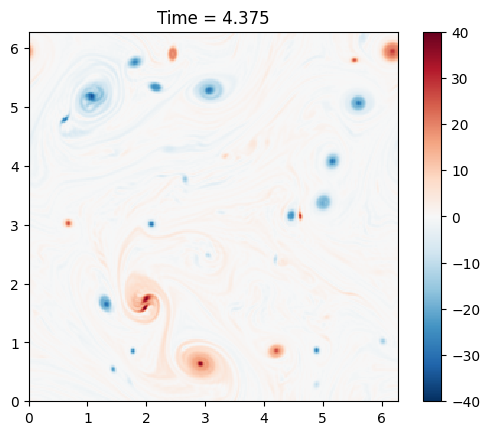

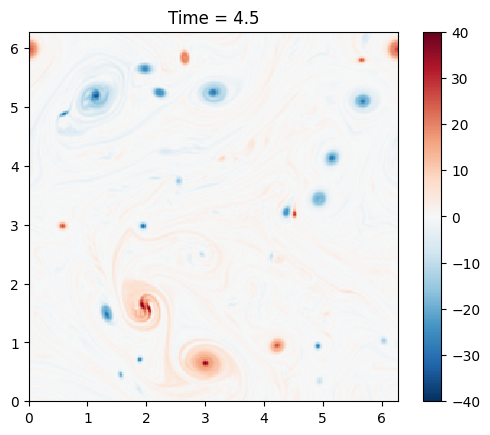

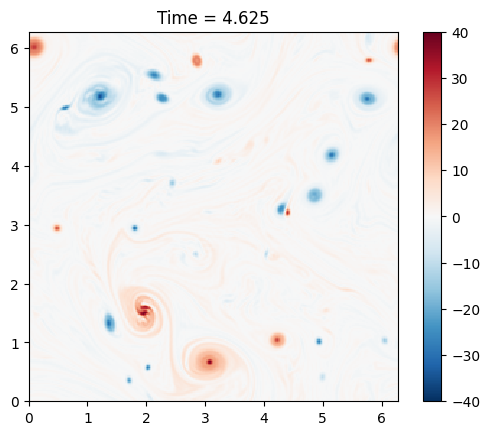

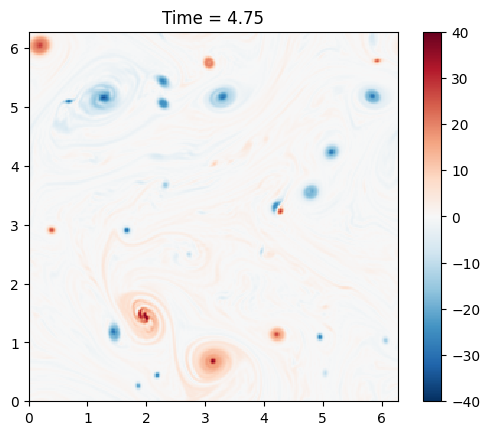

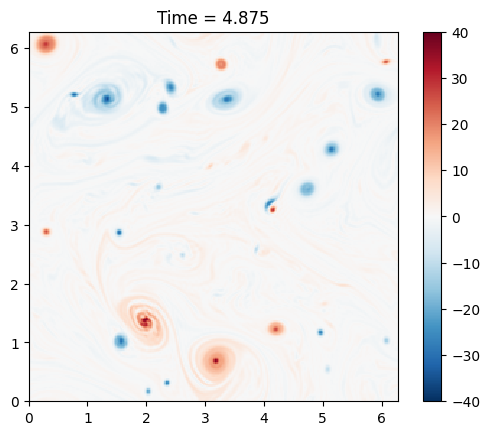

INFO: Step: 5000, Time: 5.00e+00, KE: 4.93e-01, CFL: 0.099


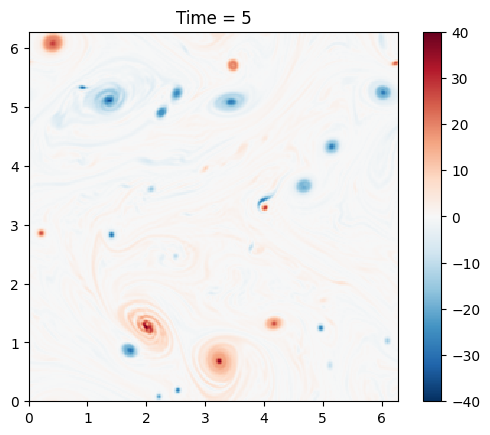

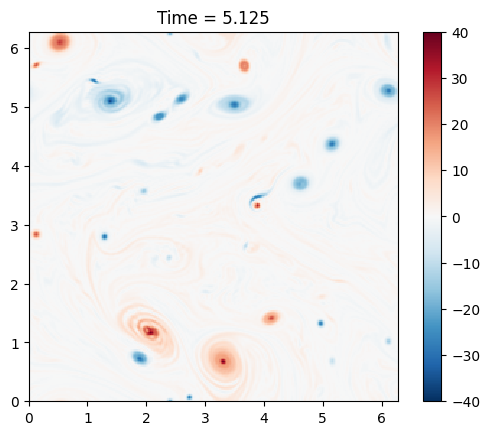

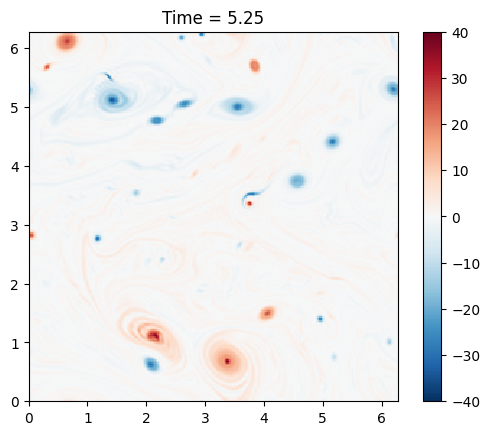

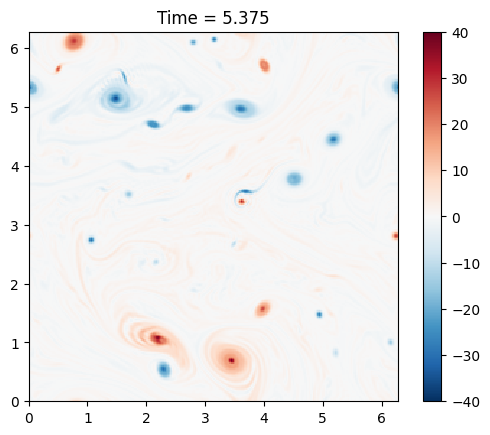

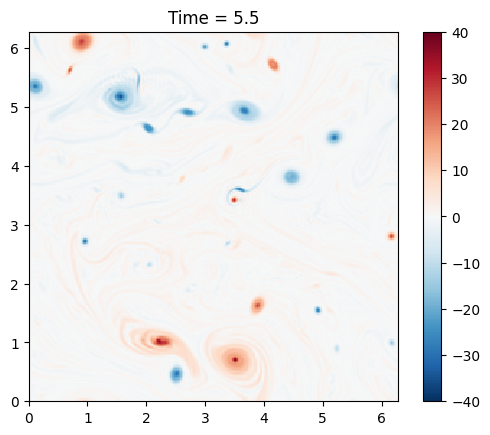

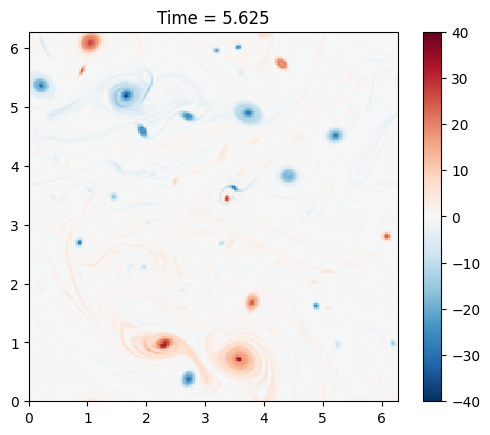

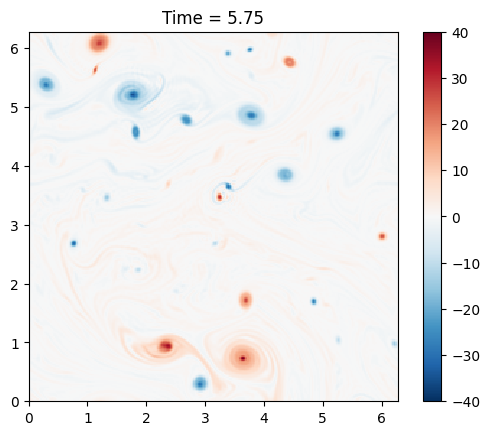

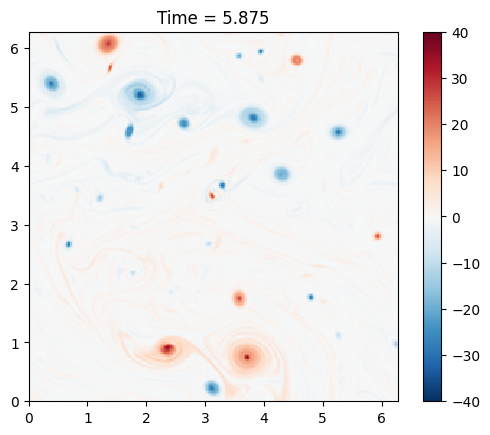

INFO: Step: 6000, Time: 6.00e+00, KE: 4.93e-01, CFL: 0.119


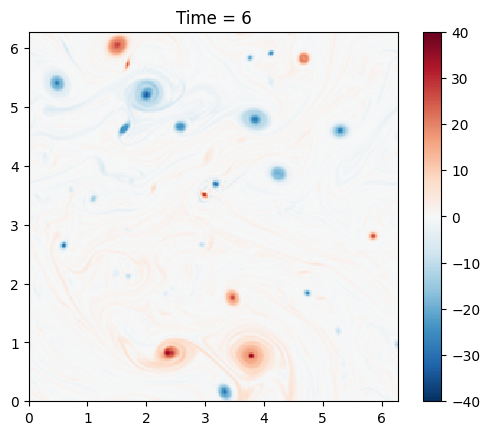

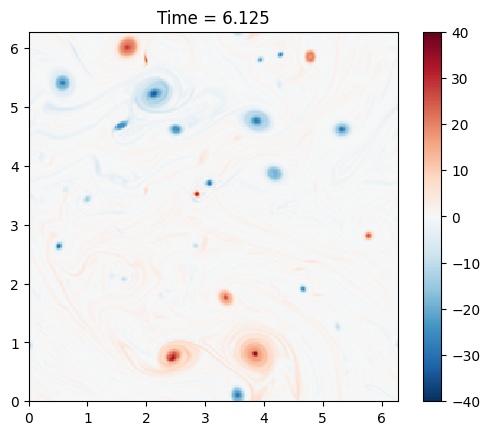

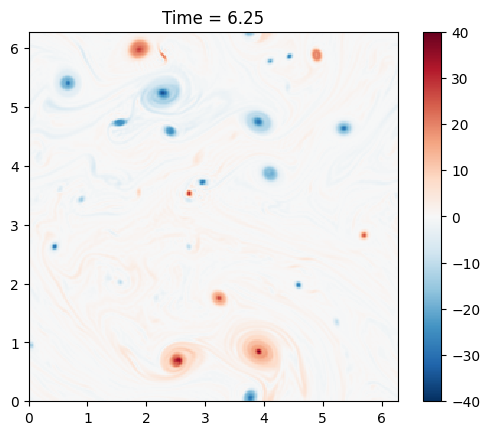

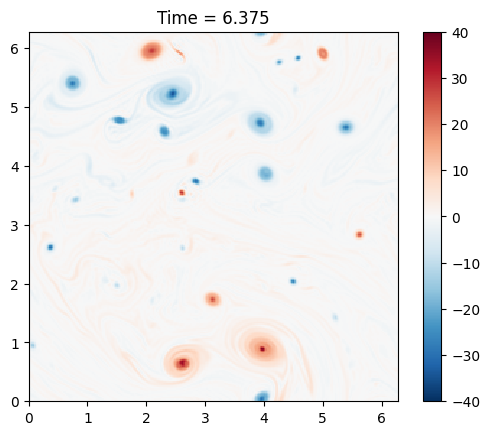

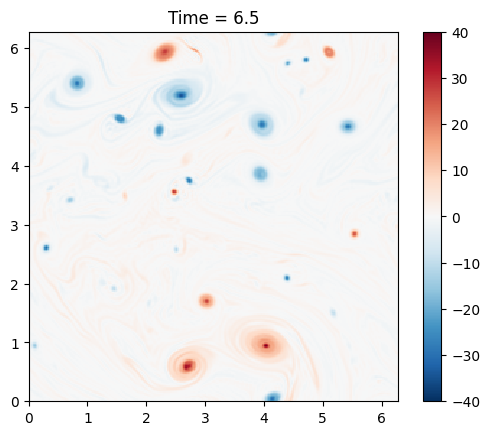

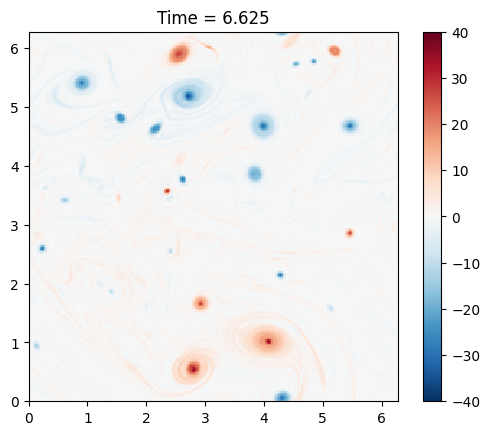

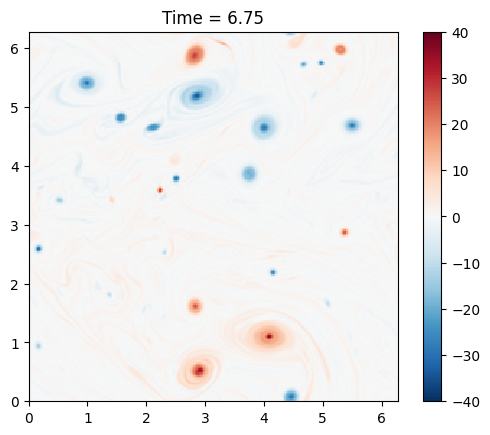

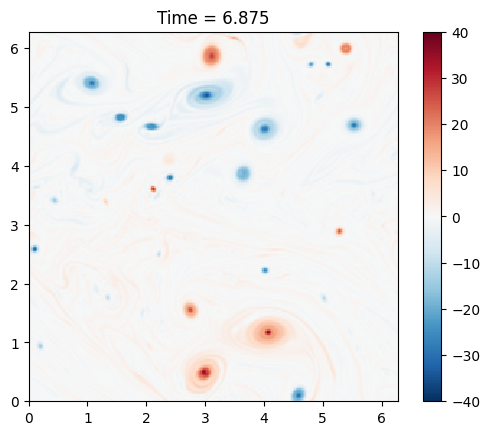

INFO: Step: 7000, Time: 7.00e+00, KE: 4.93e-01, CFL: 0.150


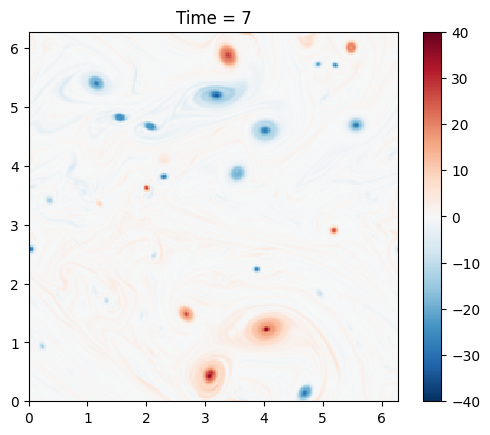

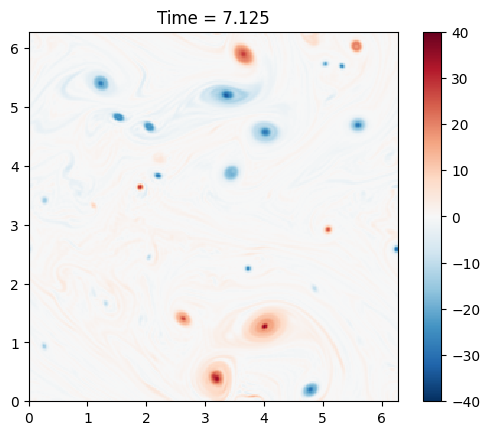

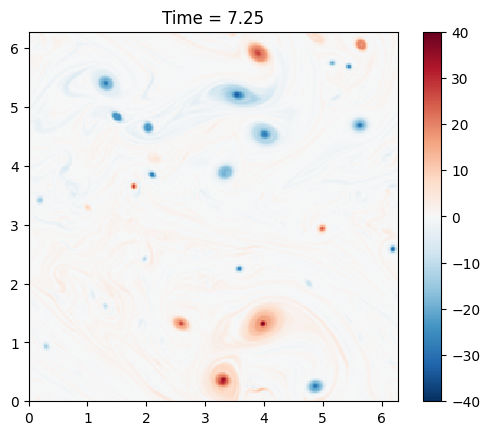

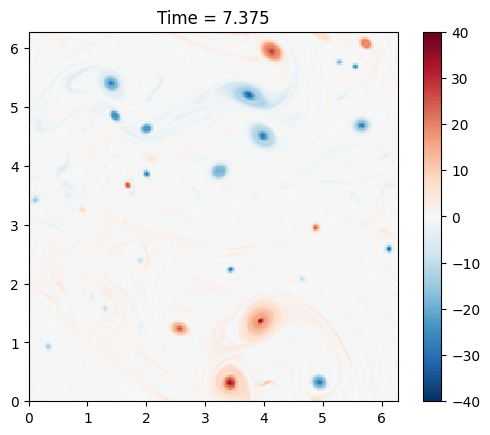

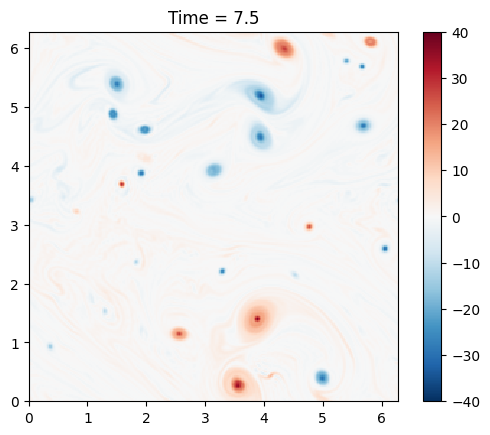

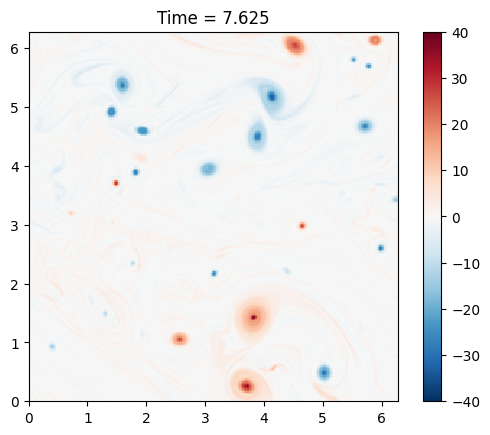

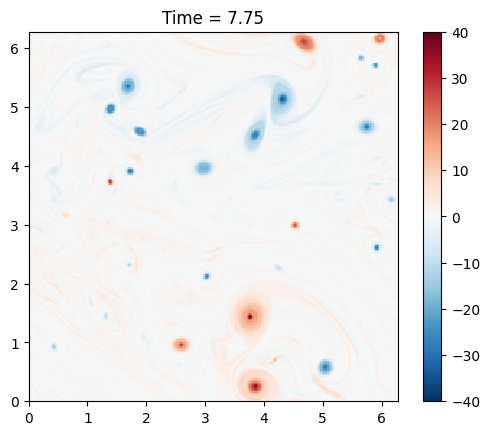

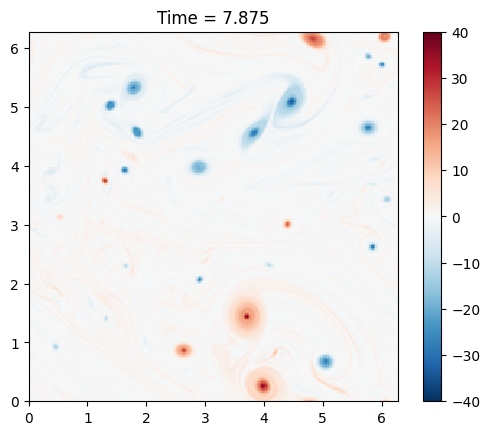

INFO: Step: 8000, Time: 8.00e+00, KE: 4.93e-01, CFL: 0.111


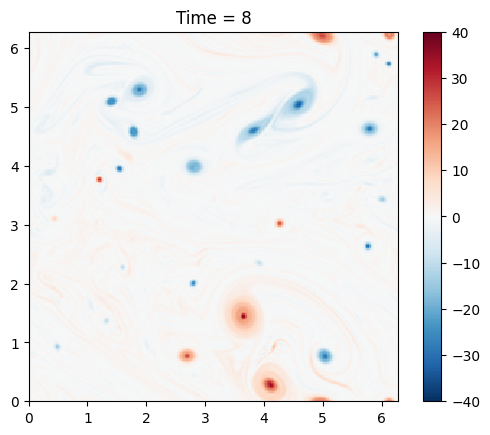

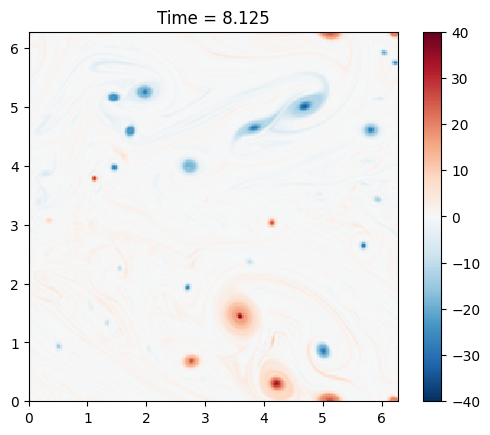

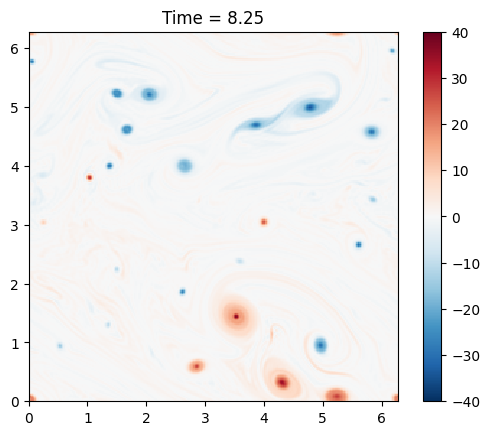

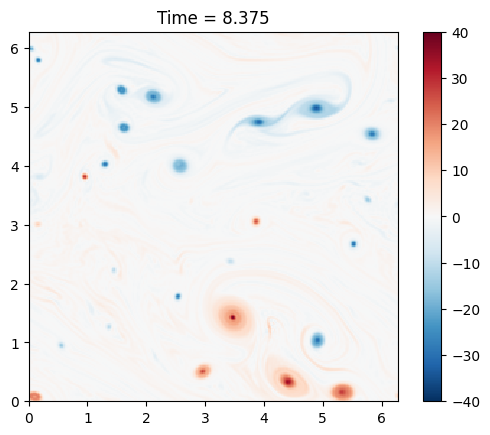

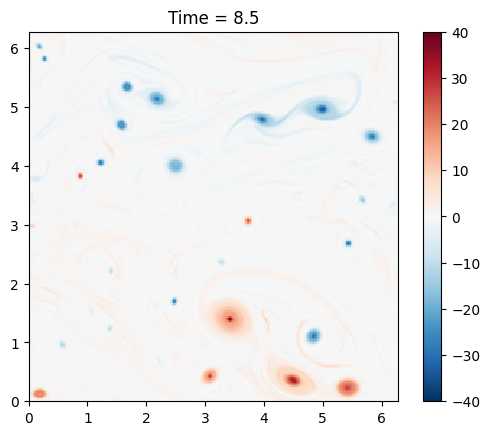

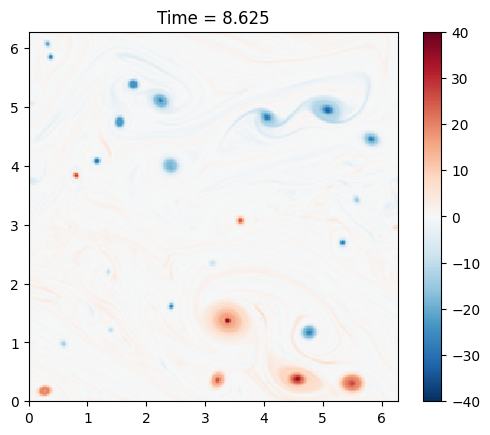

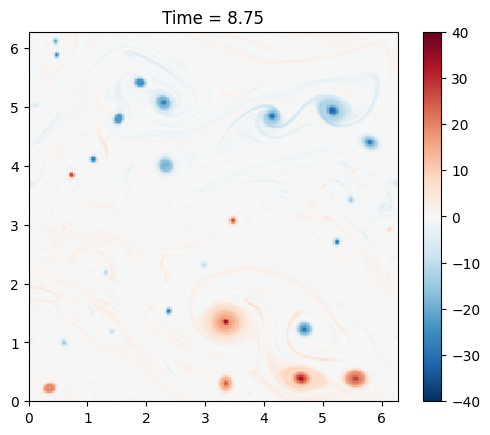

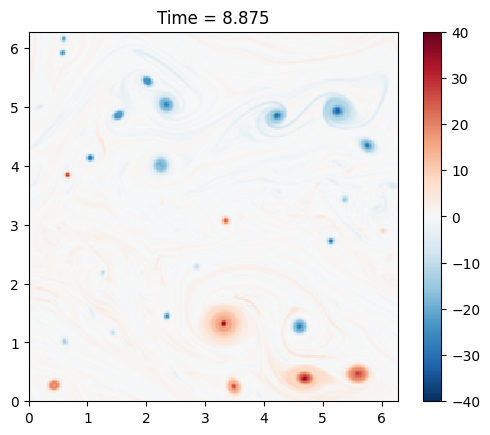

INFO: Step: 9000, Time: 9.00e+00, KE: 4.93e-01, CFL: 0.100


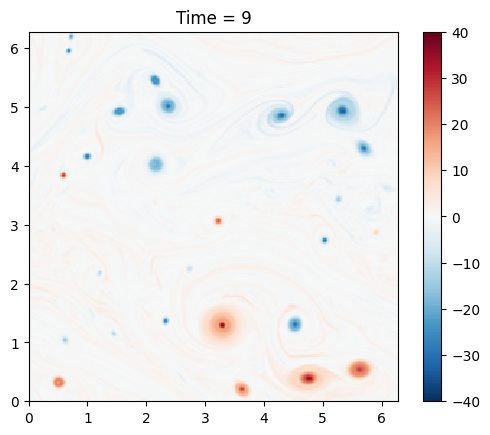

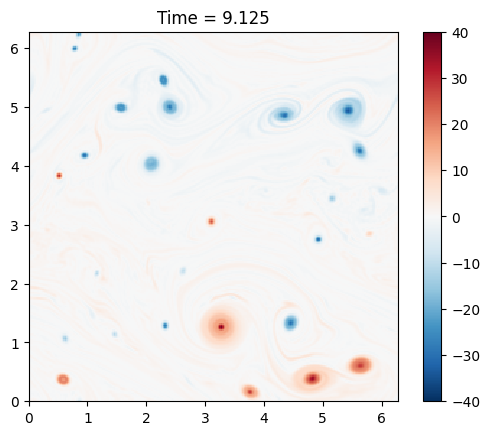

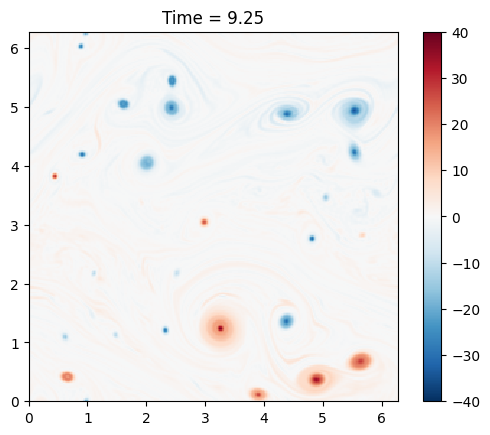

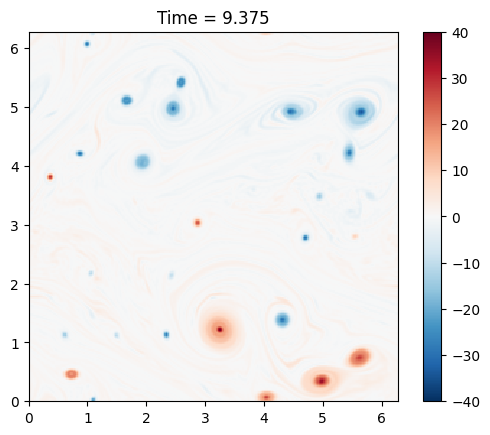

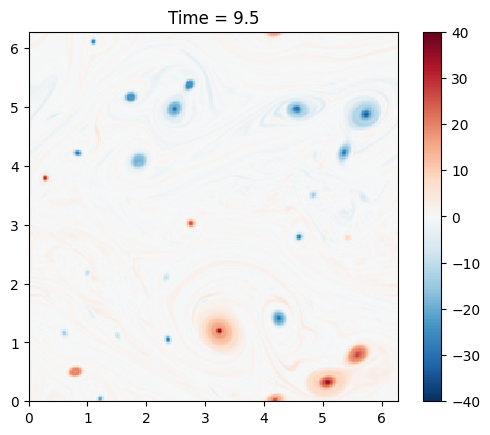

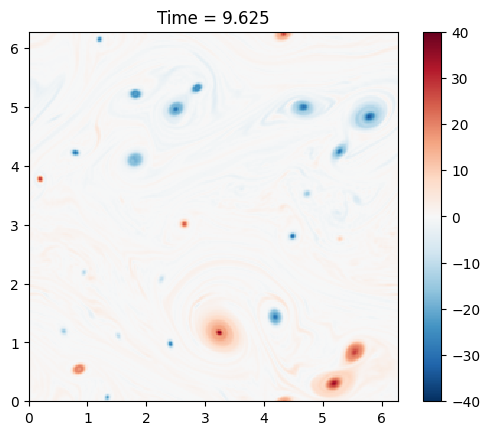

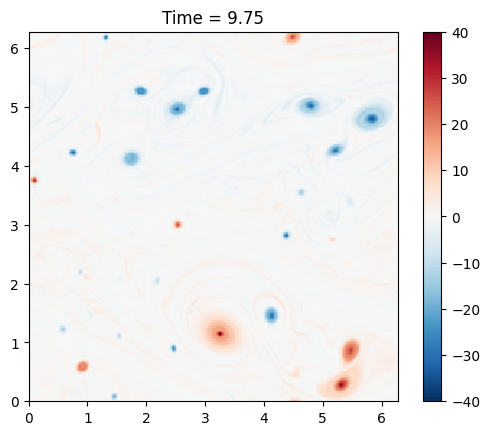

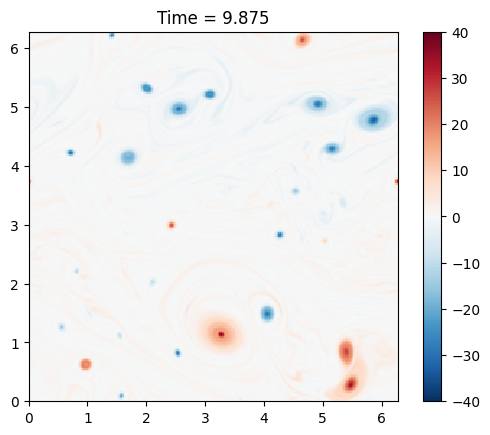

INFO: Step: 10000, Time: 1.00e+01, KE: 4.93e-01, CFL: 0.104


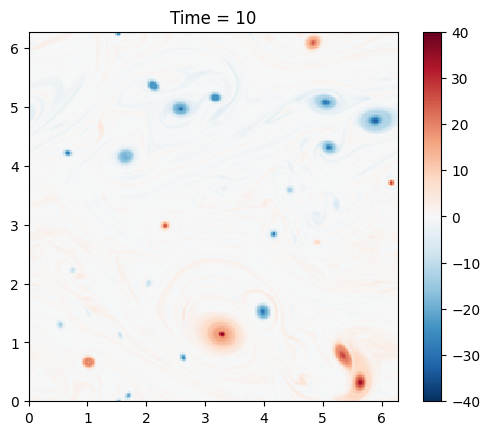

In [ ]:
# Solution storage

# Ground truth
vo_true = []
u_true = []
v_true = []

# Run the simulation and save the results
print('Printing ground truth model...')
for _ in m1.run_with_snapshots(tsnapstart=0, tsnapint=125*m1.dt):
  plot_q(m1)
  vo_true.append(m1.q.squeeze().copy())
  u_true.append(m1.ufull.squeeze().copy())
  v_true.append(m1.vfull.squeeze().copy())

In [ ]:
len(vo_true)

80

Printing learned model...


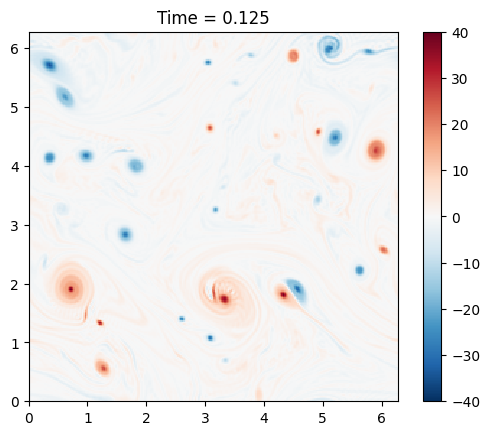

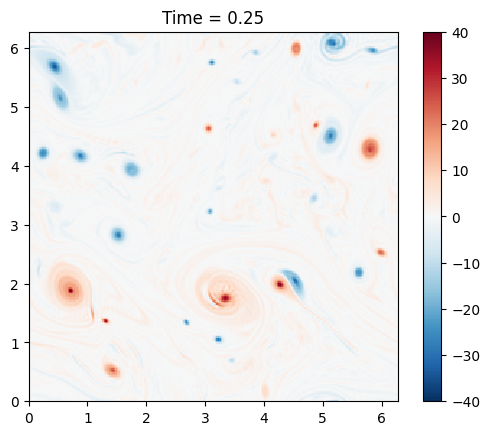

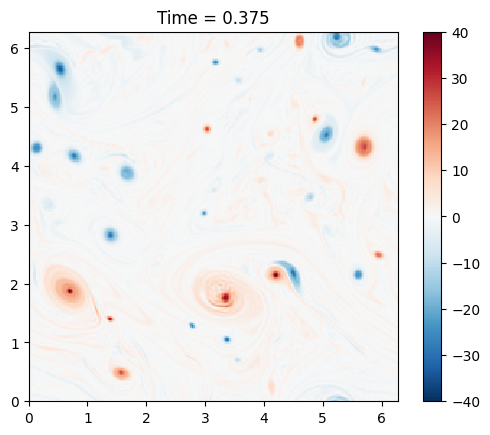

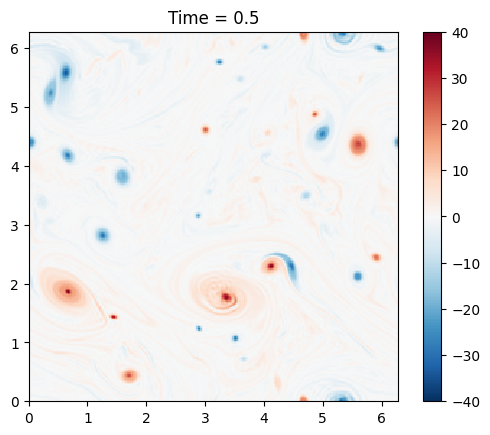

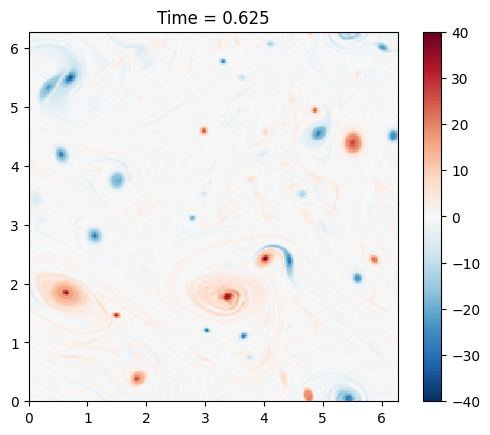

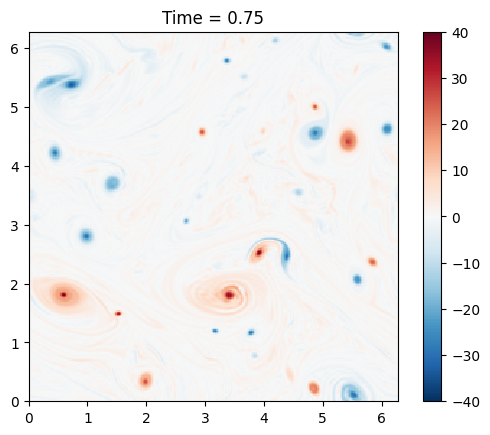

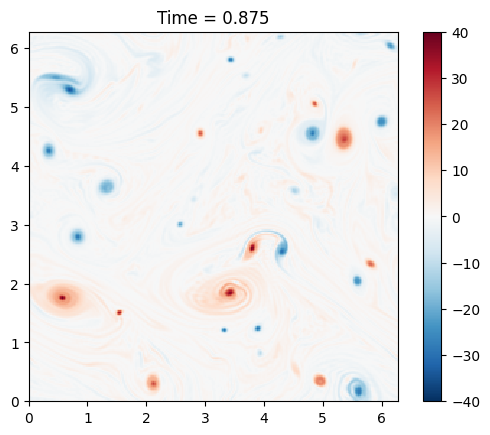

INFO: Step: 1000, Time: 1.00e+00, KE: 4.93e-01, CFL: 0.088


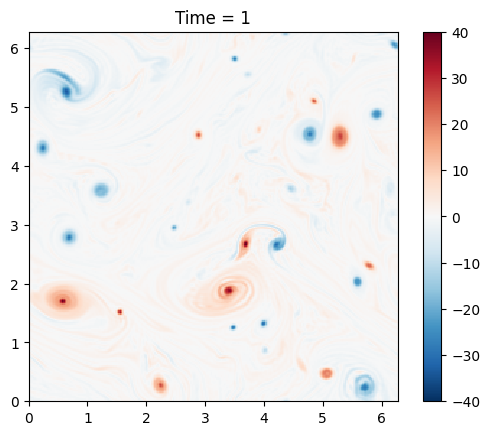

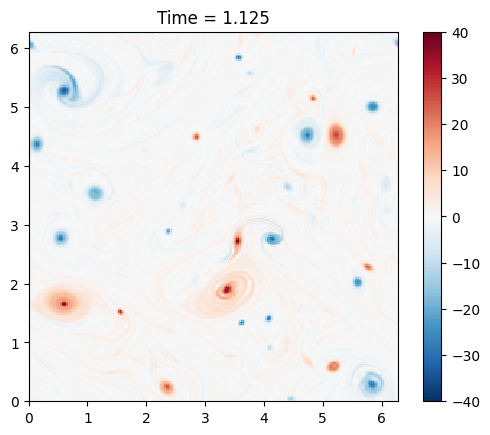

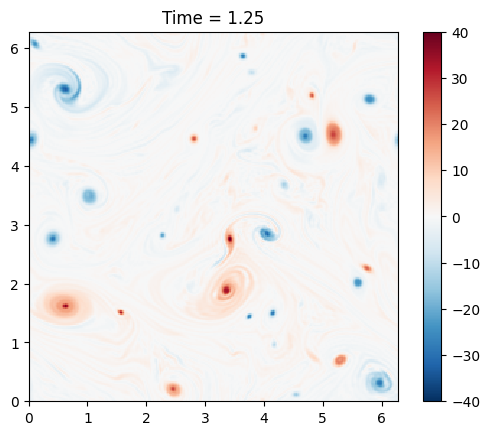

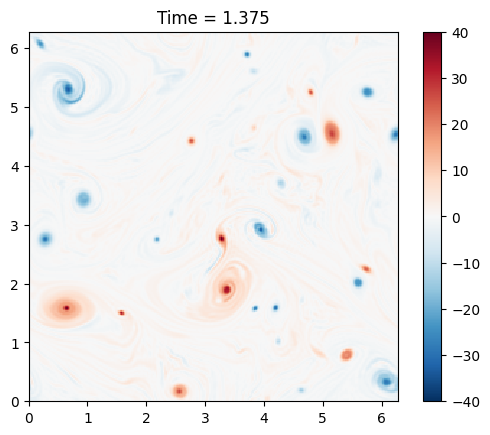

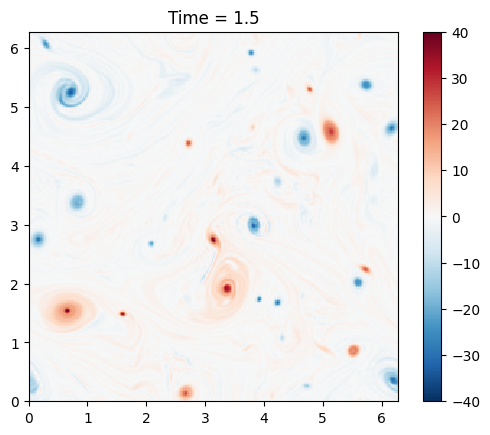

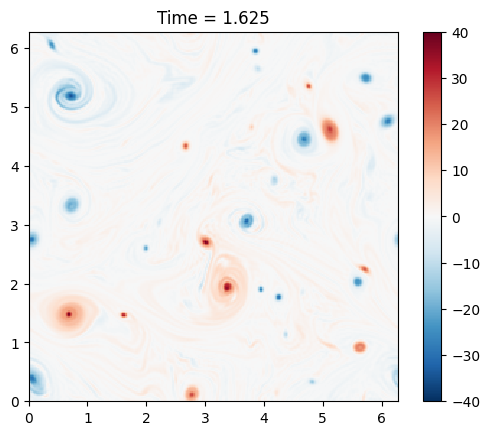

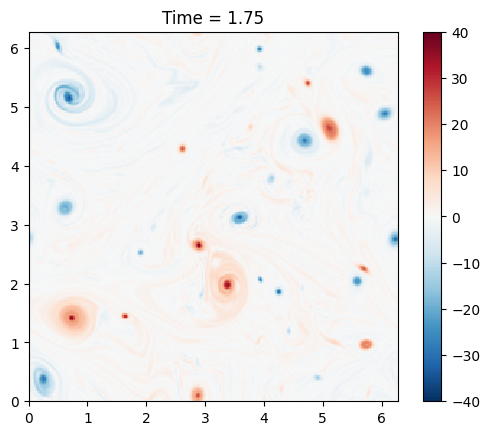

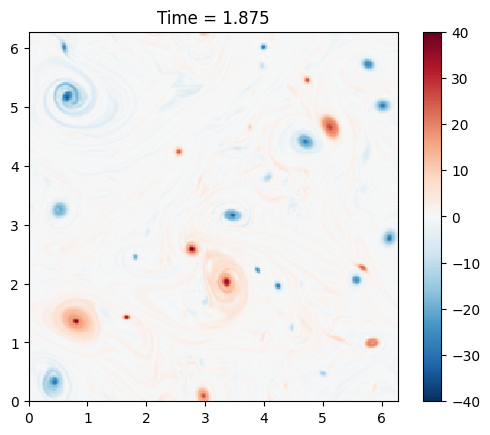

INFO: Step: 2000, Time: 2.00e+00, KE: 4.93e-01, CFL: 0.110


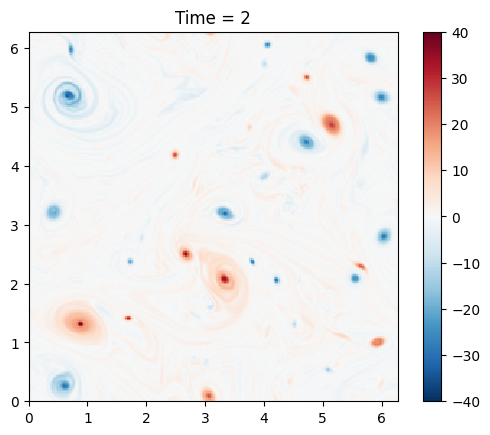

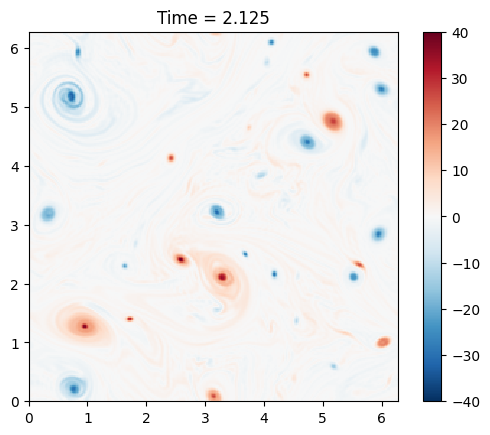

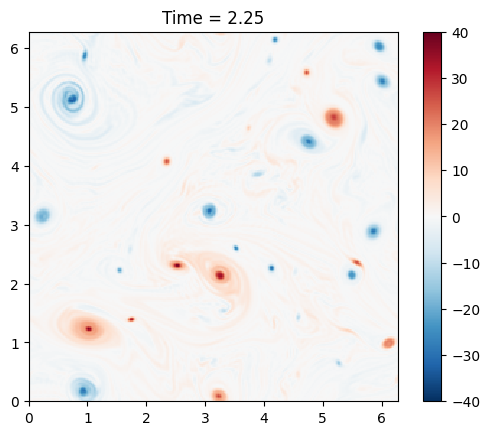

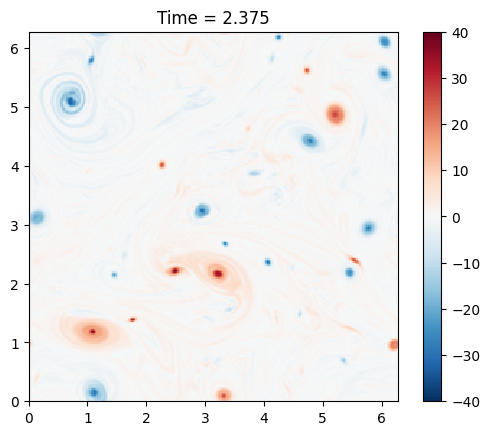

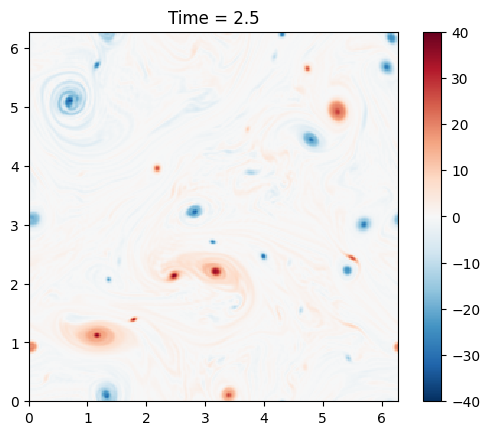

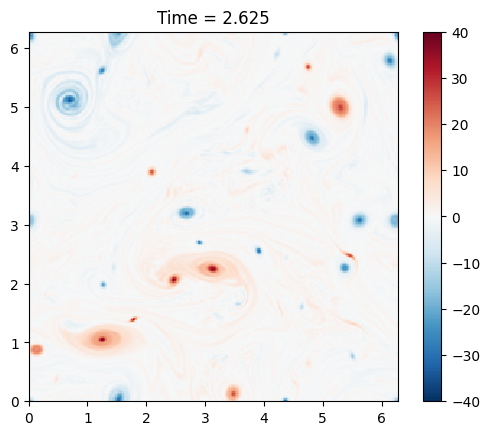

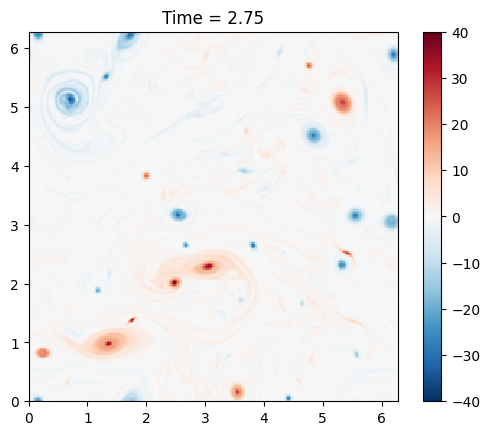

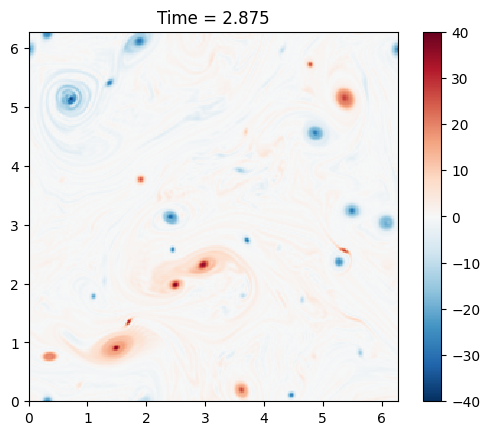

INFO: Step: 3000, Time: 3.00e+00, KE: 4.93e-01, CFL: 0.118


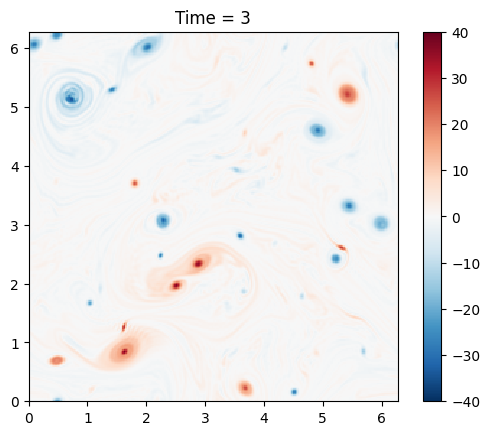

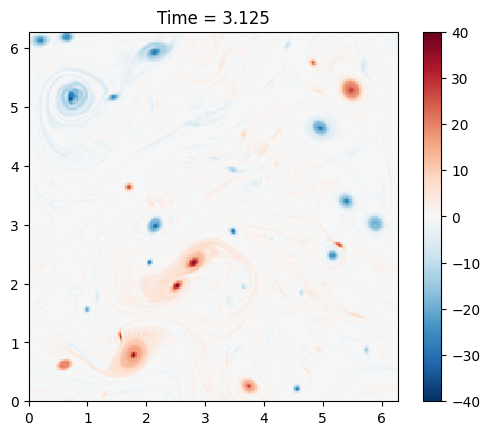

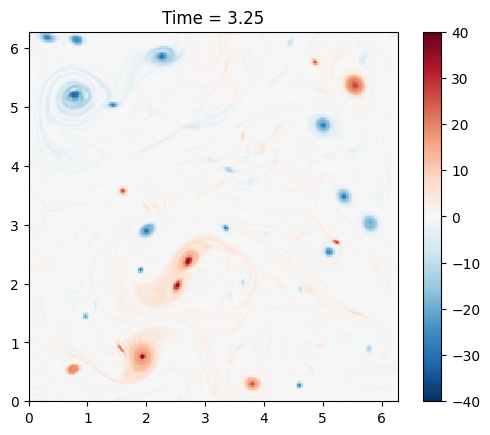

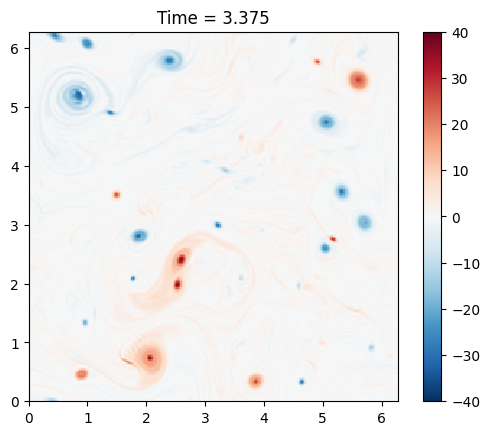

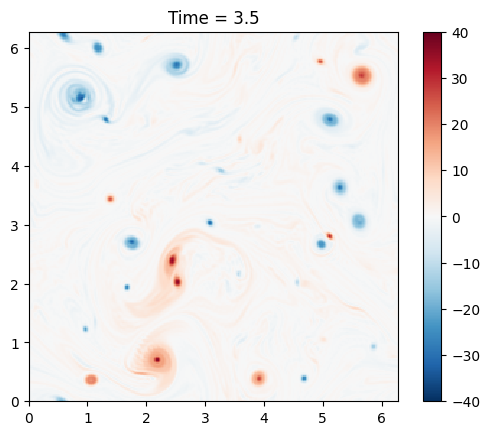

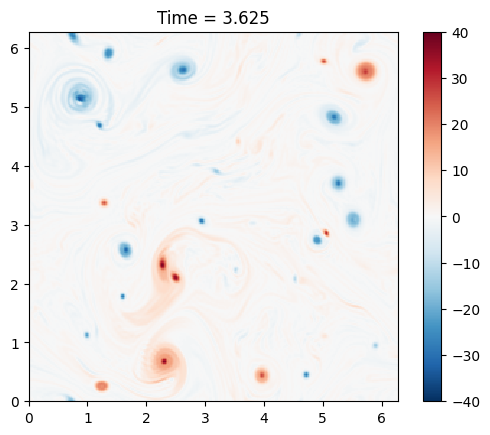

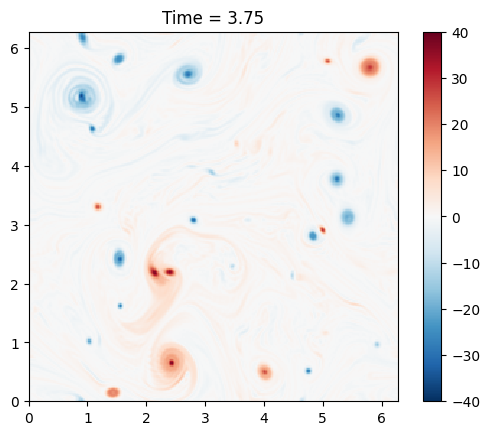

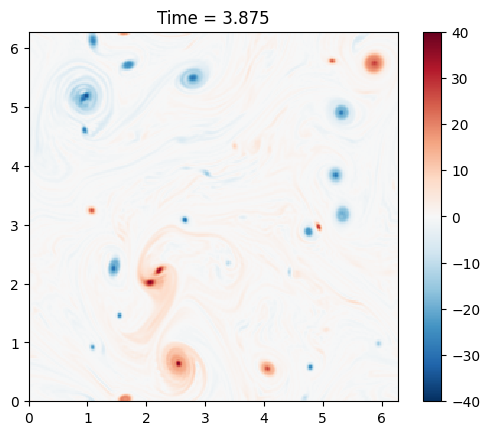

INFO: Step: 4000, Time: 4.00e+00, KE: 4.93e-01, CFL: 0.101


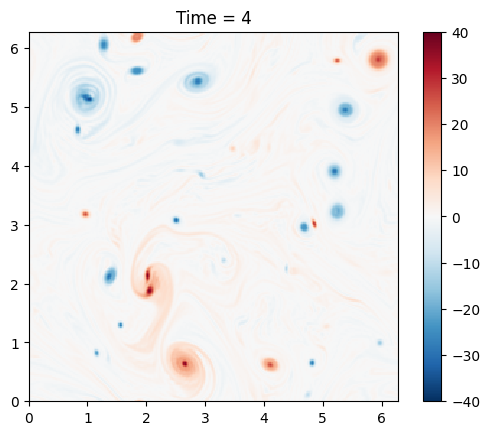

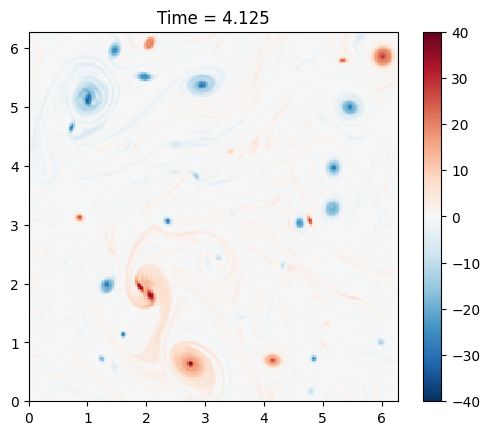

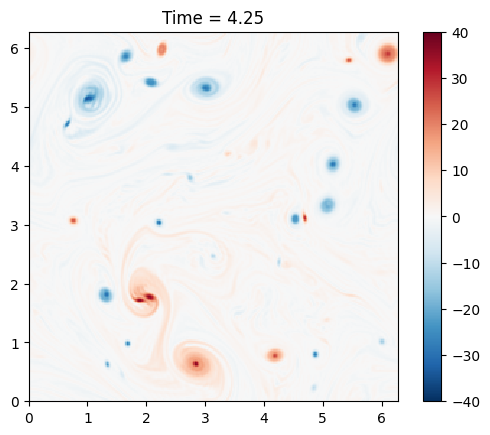

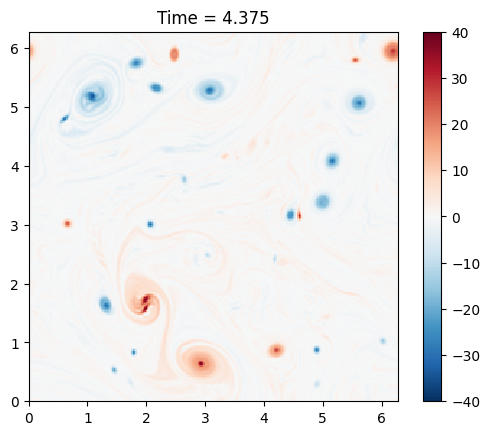

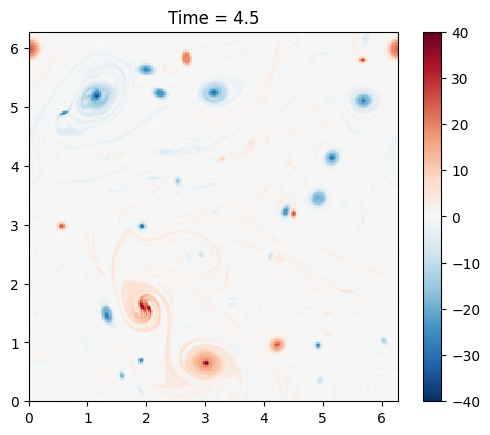

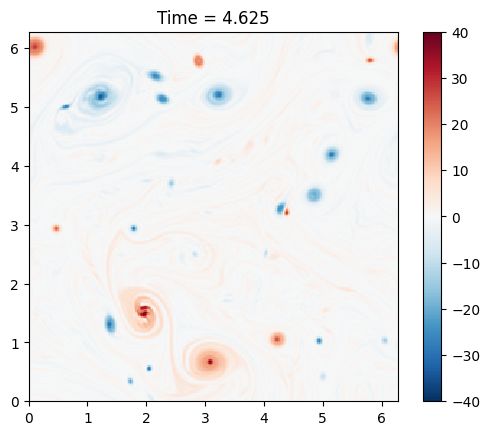

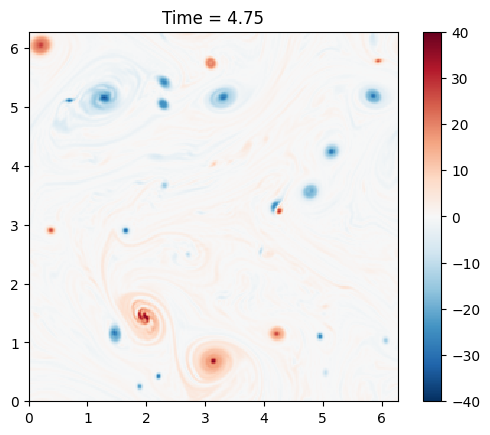

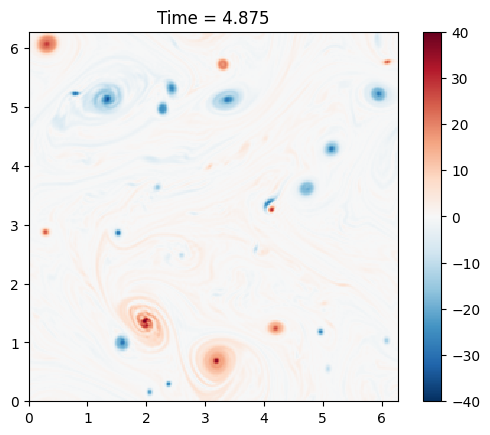

INFO: Step: 5000, Time: 5.00e+00, KE: 4.93e-01, CFL: 0.099


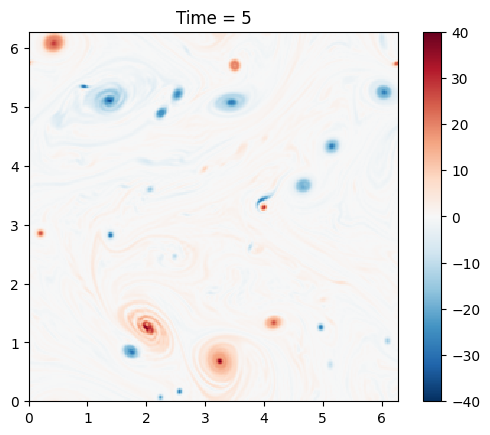

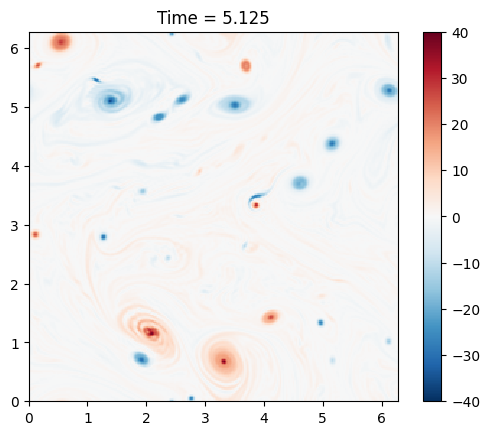

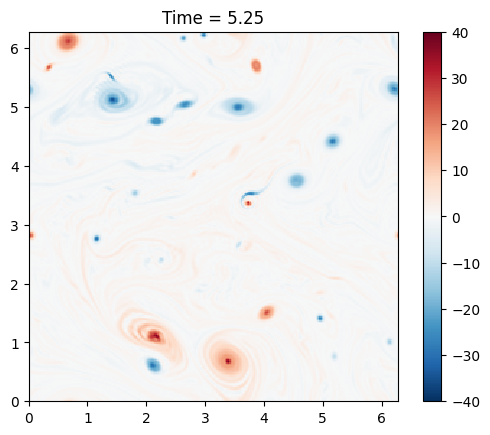

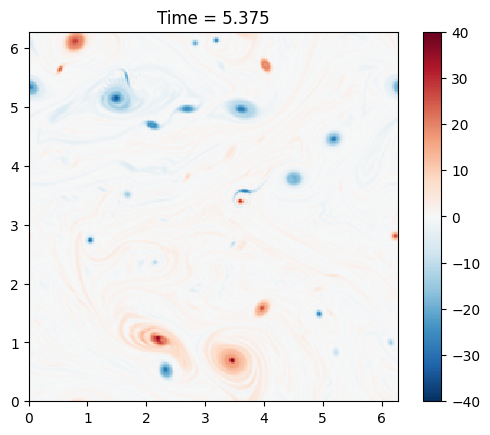

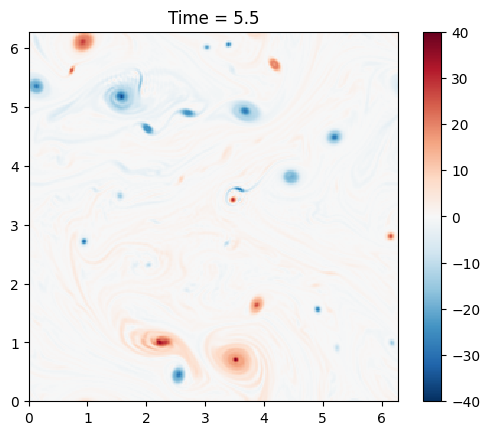

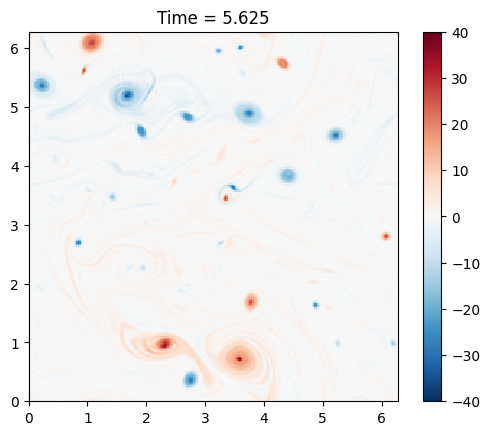

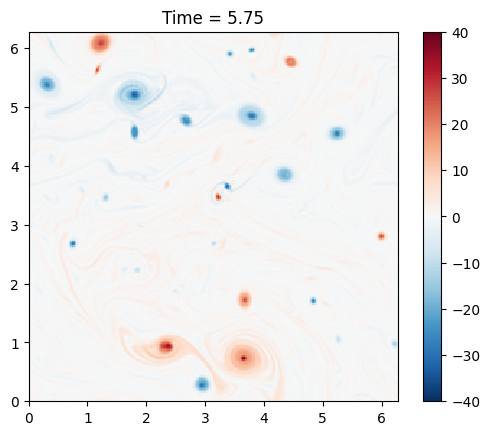

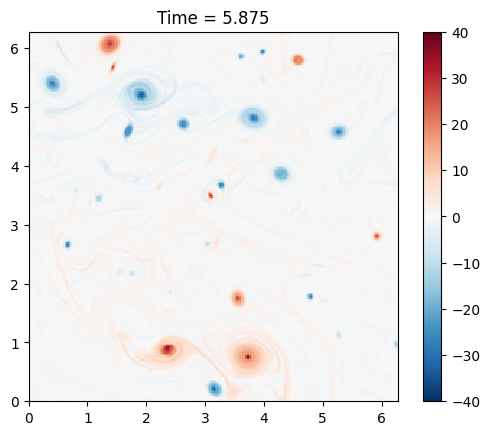

INFO: Step: 6000, Time: 6.00e+00, KE: 4.93e-01, CFL: 0.119


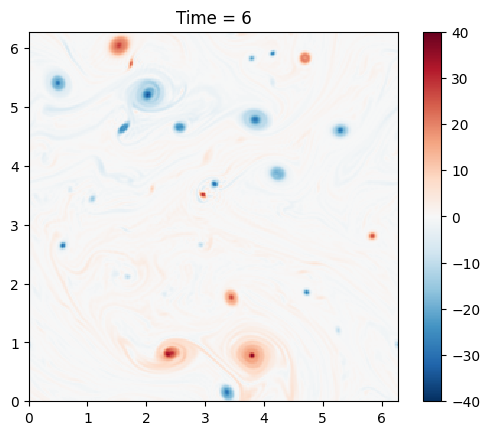

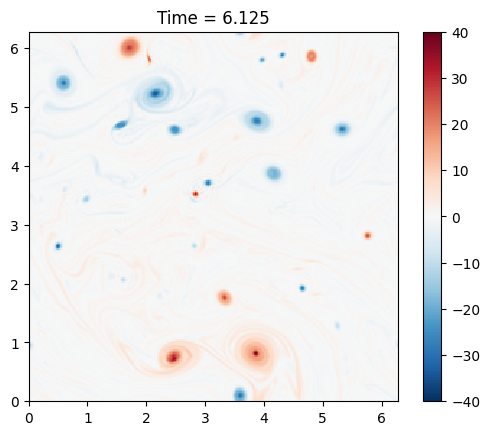

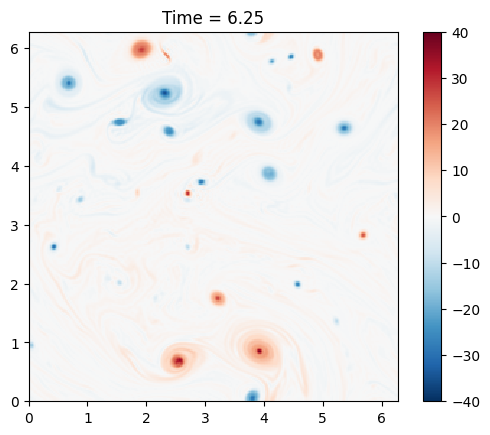

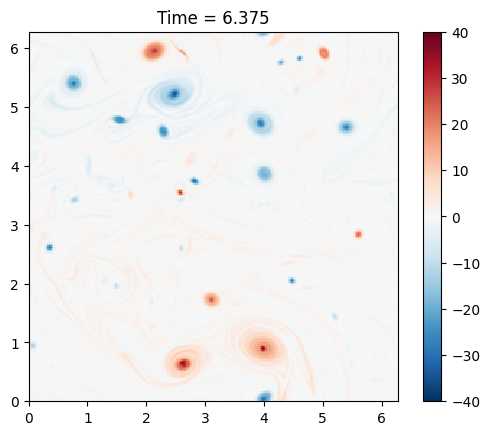

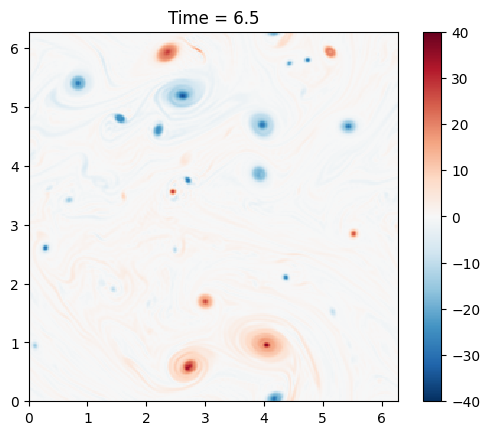

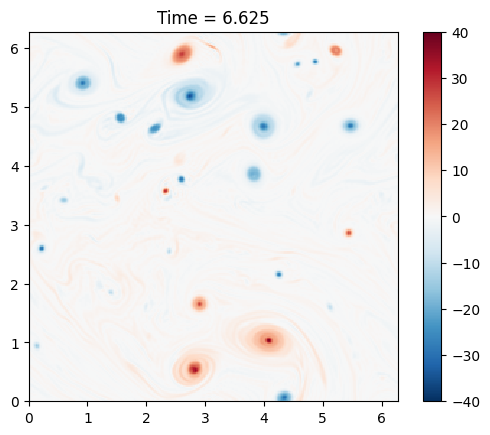

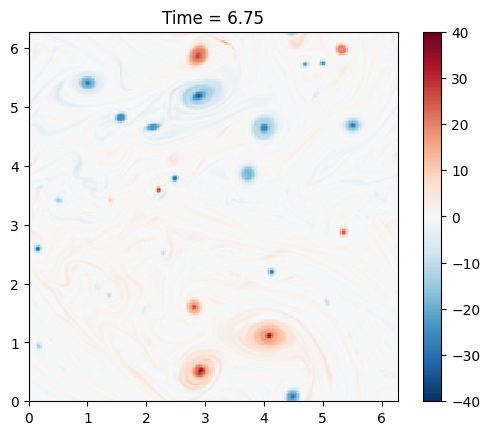

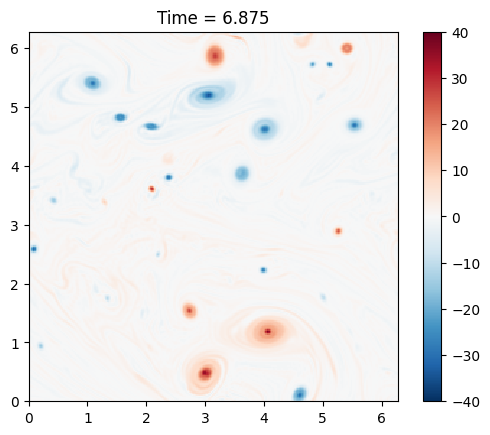

INFO: Step: 7000, Time: 7.00e+00, KE: 4.93e-01, CFL: 0.149


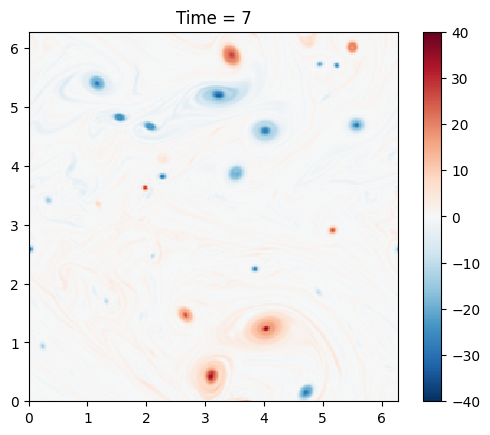

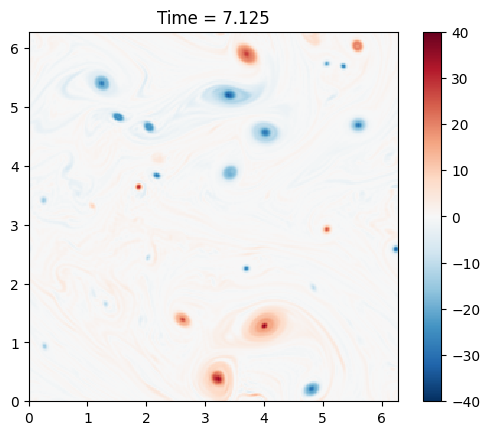

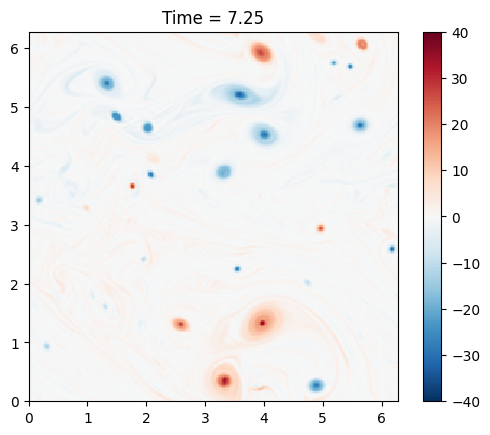

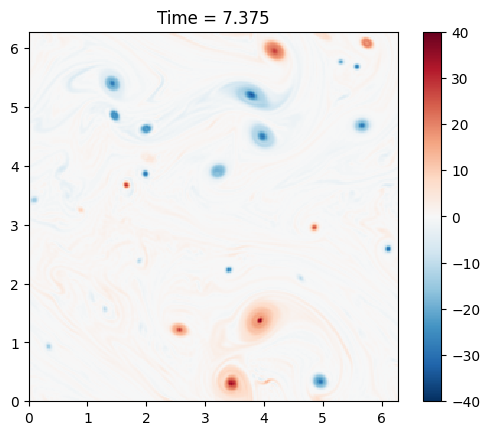

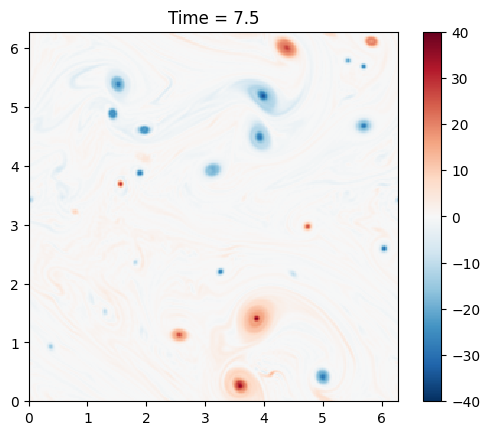

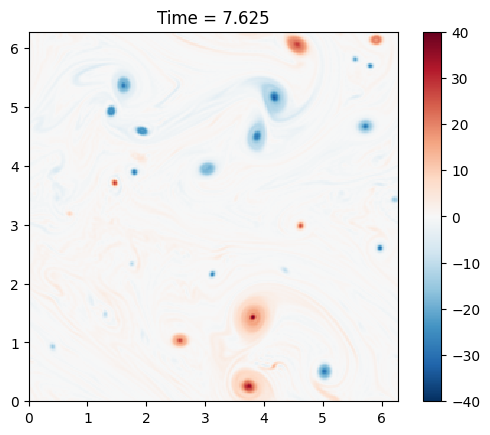

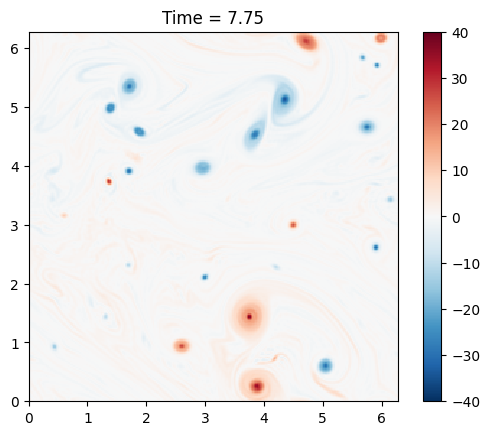

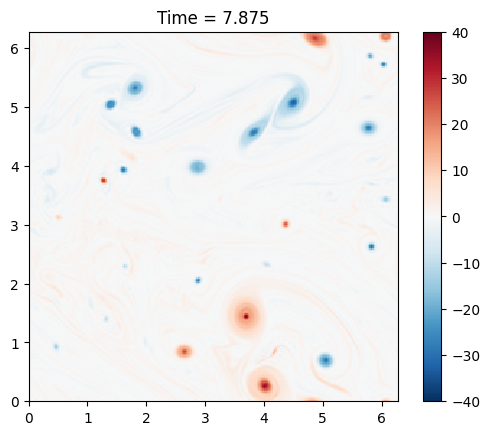

INFO: Step: 8000, Time: 8.00e+00, KE: 4.93e-01, CFL: 0.110


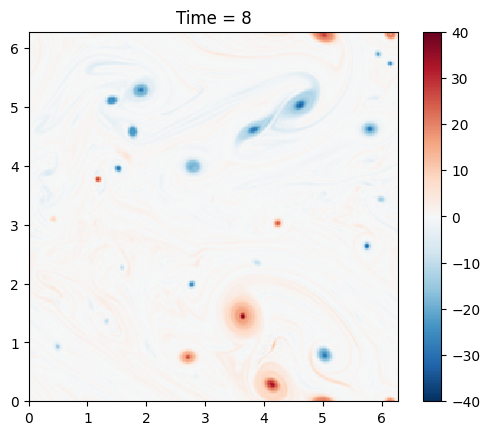

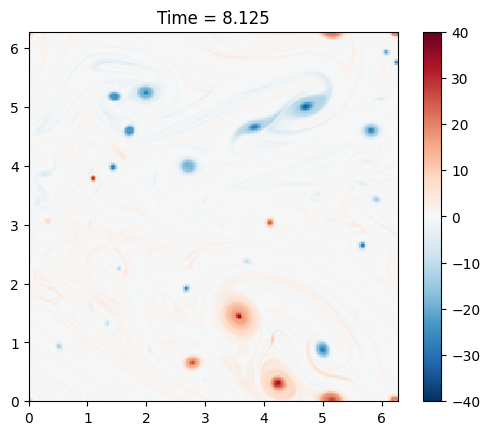

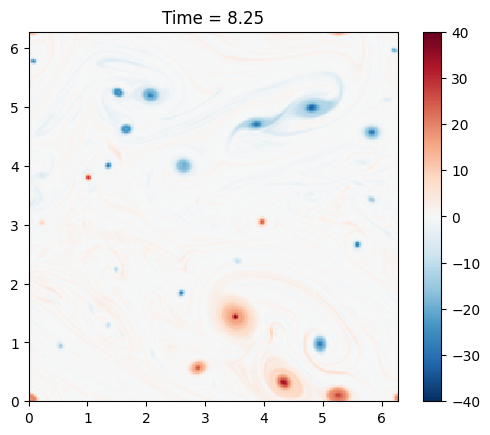

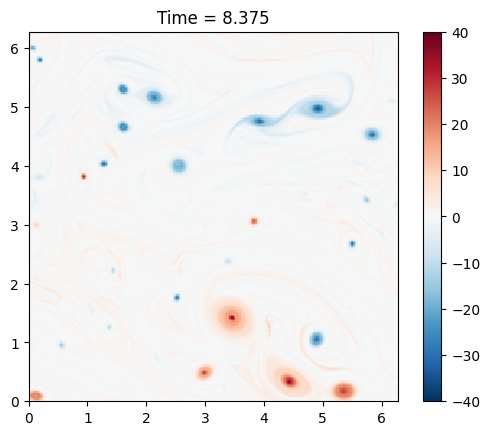

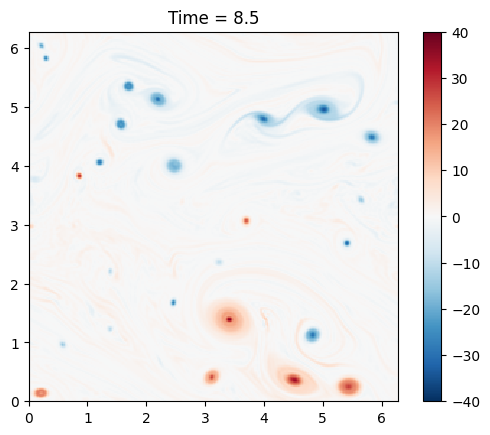

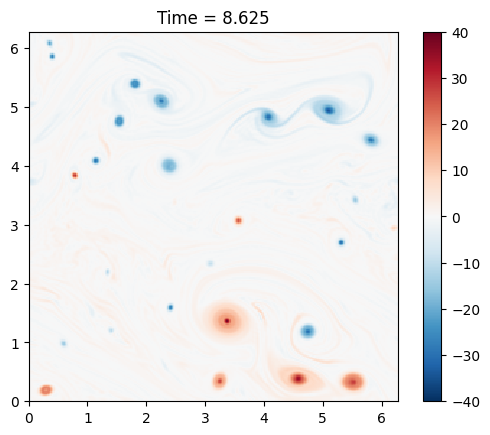

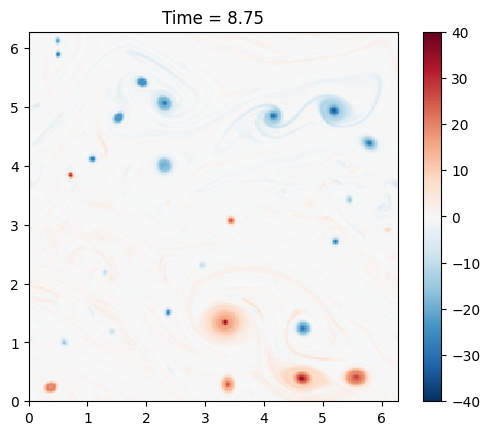

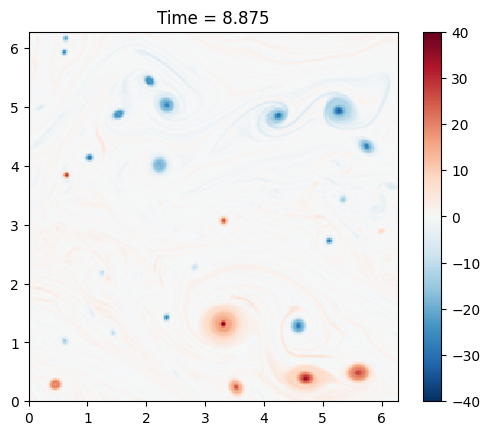

INFO: Step: 9000, Time: 9.00e+00, KE: 4.93e-01, CFL: 0.101


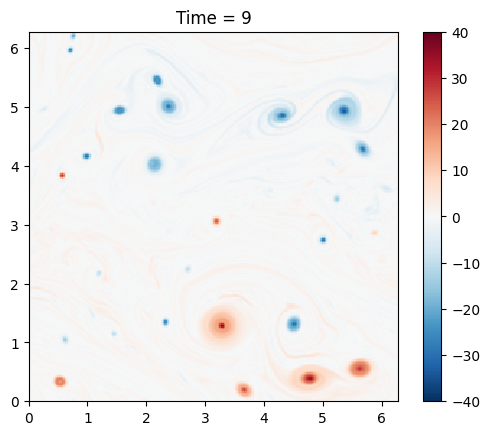

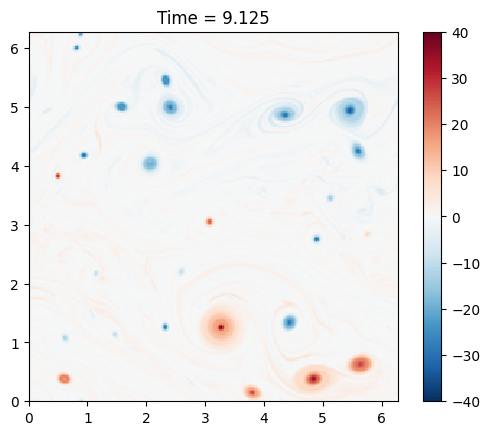

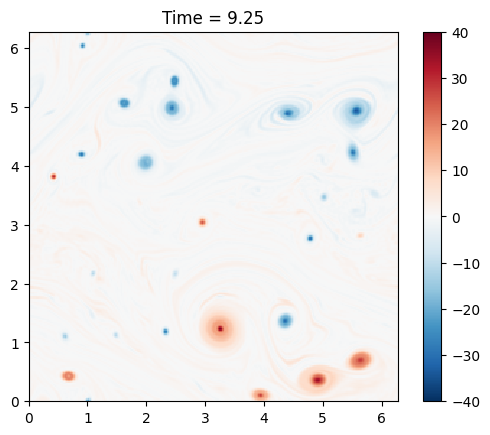

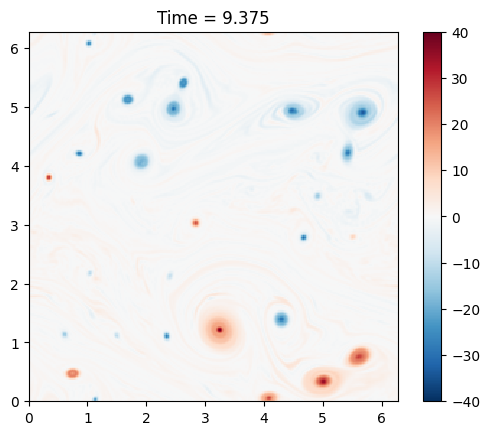

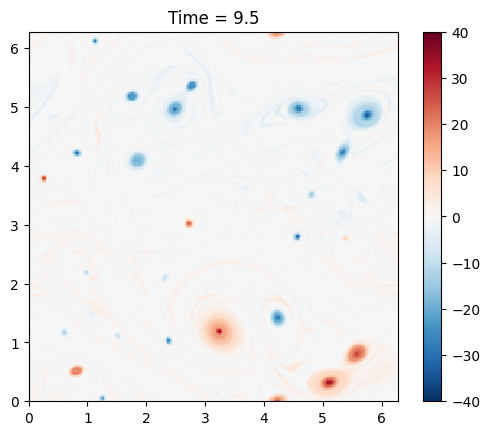

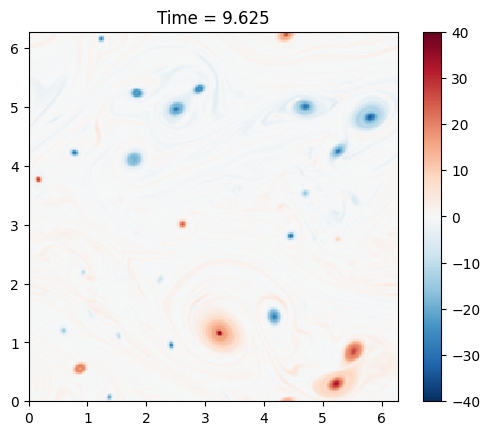

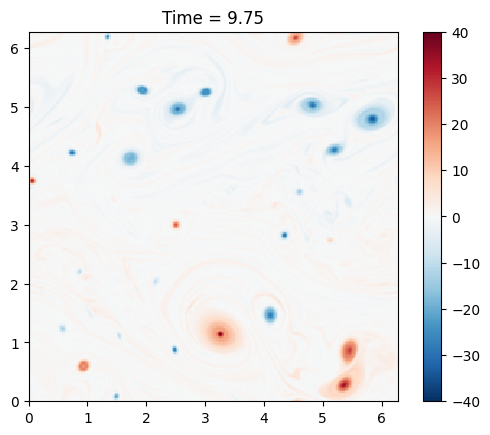

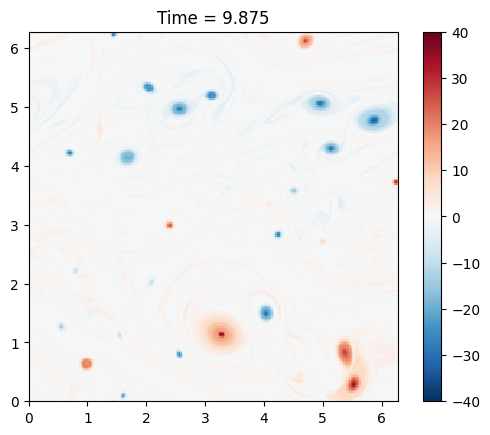

INFO: Step: 10000, Time: 1.00e+01, KE: 4.93e-01, CFL: 0.102


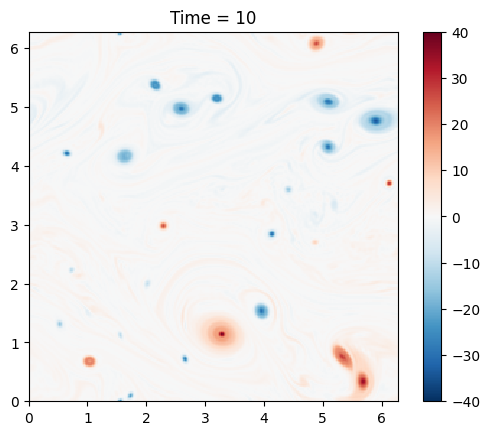

In [ ]:
# Learned model
vo_learned = []
u_learned = []
v_learned = []

# Run the simulation and save the results
print('Printing learned model...')
for _ in m2.run_with_snapshots(tsnapstart=0, tsnapint=125*m2.dt):
  plot_q(m2)
  vo_learned.append(m2.q.squeeze().copy())
  u_learned.append(m2.ufull.squeeze().copy())
  v_learned.append(m2.vfull.squeeze().copy())

In [ ]:
len(vo_learned)

80

In [ ]:
# Save as a csv?
save_csv = False

if save_csv:
  # Reshape the data
  W_ds_true = np.stack(vo_true, axis=-1)
  W_ds_learned = np.stack(vo_learned, axis=-1)

  W_csv = W_ds_true.reshape((256**2,80))
  #W_csv = W_ds_learned.reshape((256**2,80))

  # Export as csv
  #np.savetxt("ground_truth.csv", W_csv, delimiter=",")
  #np.savetxt("prediction.csv", W_csv, delimiter=",")
  del W_csv

In [ ]:
W_ds_true.shape, W_ds_learned.shape

((256, 256, 80), (256, 256, 80))

In [ ]:
# Make a movie?
make_movie = False

def movie_update(t):
  pcm1.set_array(W_ds_true[:,:,t].ravel())
  pcm2.set_array(W_ds_learned[:,:,t].ravel())
  pcm3.set_array(abs(W_ds_true-W_ds_learned)[:,:,t].ravel())
  text.set_text(f'Time: $\\tau+{round(t*0.125,2)}$')

  pcm1.set_clim(vmin=np.min(W_ds_true[:,:,t]), vmax=np.max(W_ds_true[:,:,t]))
  pcm2.set_clim(vmin=np.min(W_ds_learned[:,:,t]), vmax=np.max(W_ds_learned[:,:,t]))
  pcm3.set_clim(vmin=np.min(abs(W_ds_true-W_ds_learned)[:,:,t]), vmax=np.max(abs(W_ds_true-W_ds_learned)[:,:,t]))
  #return [pcm]
  return [pcm1, pcm2, pcm3]

if make_movie:
  # Create a figure
  plt.rcParams['figure.figsize'] = [10, 3.6]
  fig, ax = plt.subplots(1,3)
  ax[0].set_axis_off()
  ax[1].set_axis_off()
  ax[2].set_axis_off()

  # Display the first frame
  x = np.linspace(0, 2*np.pi, 256)
  y = np.linspace(0, 2*np.pi, 256)
  pcm1 = ax[0].pcolormesh(x, y, W_ds_true[:,:,0], cmap='RdBu_r')
  pcm2 = ax[1].pcolormesh(x, y, W_ds_learned[:,:,0], cmap='RdBu_r')
  pcm3 = ax[2].pcolormesh(x, y, abs(W_ds_true-W_ds_learned)[:,:,0], cmap='binary')
  plt.colorbar(pcm1, orientation='horizontal', location='bottom', pad=0.05)
  plt.colorbar(pcm2, orientation='horizontal', location='bottom', pad=0.05)
  plt.colorbar(pcm3, orientation='horizontal', location='bottom', pad=0.05)
  #ax[0].set_xlabel('$x$')
  #ax[0].set_ylabel('$y$')
  text = ax[0].text(0.08, 6.2, f'Time: $\\tau+{0}$', color='black', fontsize=10, ha='left', va='top')
  ax[0].set_title(f'Ground Truth')
  ax[1].set_title(f'Learned Model')
  ax[2].set_title(f'Absolute Error')
  plt.show()

  # Create and save movie
  #from matplotlib.animation import FuncAnimation
  #ani = FuncAnimation(fig, movie_update, frames=80, blit=True)
  #ani.save('wsindy_comparison.mp4', writer='ffmpeg', fps=20, dpi=400)

Compare Statistics

In [ ]:
# Kinetic energy spectrum
energy1 = m1.get_diagnostic('KEspec')
energy2 = m2.get_diagnostic('KEspec')

In [ ]:
# this makes it easy to calculate an isotropic spectrum
from pyqg import diagnostic_tools as tools
kr1, energy_iso1 = tools.calc_ispec(m1,energy1.squeeze())
kr2, energy_iso2 = tools.calc_ispec(m2,energy2.squeeze())

Text(0.5, 1.0, 'Kinetic Energy Spectrum')

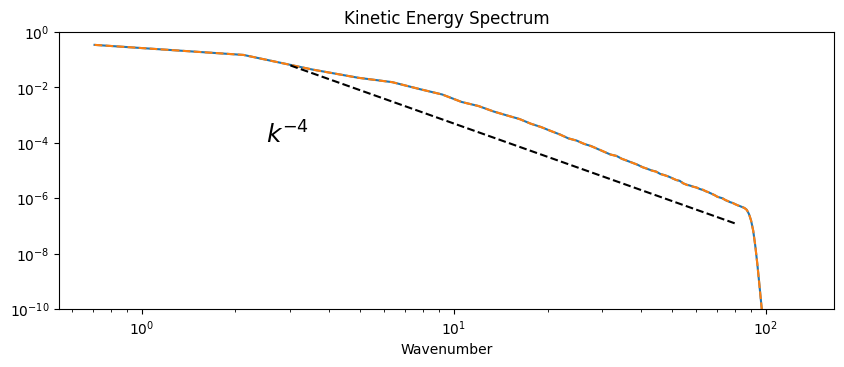

In [ ]:
%matplotlib inline

ks = np.array([3.,80]) # "k's"
es = 5*ks**-4          # KE spectrum
#plt.loglog(kr1, energy_iso1-energy_iso2, ls='-')
plt.loglog(kr1, energy_iso1, ls='-')
plt.loglog(kr2,energy_iso2, ls='dashed')
plt.loglog(ks,es,'k--')
plt.text(2.5,.0001,r'$k^{-4}$',fontsize=18)
plt.ylim(1.e-10,1.e0)
plt.xlabel('Wavenumber')
plt.title('Kinetic Energy Spectrum')

### Diagnostics

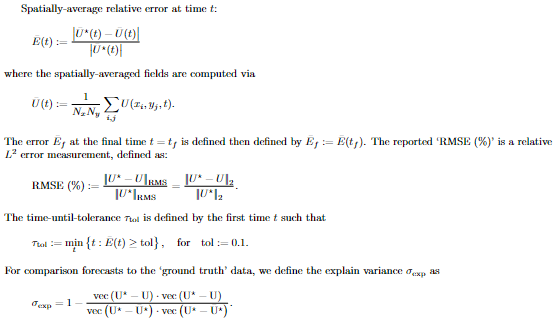

In [ ]:
print(W_true.shape, W_pred.shape)

torch.Size([256, 256, 80]) torch.Size([256, 256, 80])


In [ ]:
# Error (relative L2) between ground truth and prediction
error = abs(W_true - W_pred)

# Time series of average spatial error
Et = error.mean(dim=(0,1))
Et_rel = Et/abs(W_true).mean(dim=(0,1))

# Time until tolerance
t = np.linspace(0.125, 10, 80)
t_tol_index = torch.where(Et_rel>0.1, True, False).nonzero()[0]
t_tol = t[t_tol_index]

# Percentage RMSE
rmse = (torch.linalg.norm(W_true-W_pred)/torch.norm(W_true)).item()

# Explained variance
top = torch.dot((W_true-W_pred).reshape(-1), (W_true-W_pred).reshape(-1))
bot = torch.dot((W_true-W_true.mean()).reshape(-1), (W_true-W_true.mean()).reshape(-1))
var_exp = 1 - (top/bot).item()

# Print some results
print(f'Relative RMSE = {round(rmse,5)}')
print(f'Explained var = {round(var_exp,5)}')
print(f't_tol = {t_tol}')
print(f'E_f = {round(Et_rel[-1].item(),5)}')

Relative RMSE = 0.20673
Explained var = 0.95726
t_tol = 2.5
E_f = 0.34536


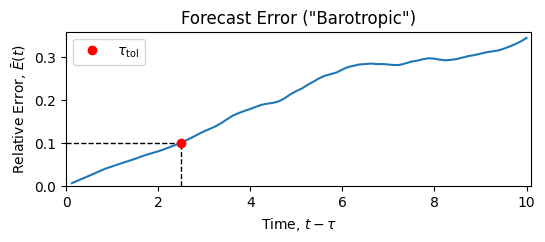

In [ ]:
# Plot that time series
plt.rcParams['figure.figsize'] = [6, 2]
fig, ax = plt.subplots(1)

# Display the first frame
t = np.linspace(0.125, 10, 80)
#ax.plot(t, Et)
ax.plot(t, Et_rel)
ax.axvline(x=t_tol, ymin=0, ymax=0.285, ls='--', color='k', lw=1)
ax.axhline(y=Et_rel[t_tol_index], xmin=0, xmax=0.25, ls='--', color='k', lw=1)
ax.plot(t_tol, Et_rel[t_tol_index], 'ro', label='$\\tau_{\\rm{tol}}$')
ax.set_xlabel('Time, $t-\\tau$')
ax.set_ylabel('Relative Error, $\\bar{E}(t)$')
ax.set_title(f'Forecast Error ("Barotropic")')
ax.set_xlim([0, 10.1])
ax.set_ylim([0, 0.36])
ax.legend()
plt.show()

### Lagrangian Particles and Lyapunov Exponents

For a tracer $\mathbf{x} = \mathbf{x}(t)$ moving with the wind $\mathbf{u}$, \begin{align*}
\dot{\mathbf{x}} = f(t) = \mathbf{u}(\mathbf{x}(t), t),
\quad \text{and} \quad
\mathbf{x}(t) = \mathbf{x}_0 + \int_0^T \mathbf{u}(\mathbf{x}(t), t)dt.
\end{align*}

In [ ]:
# Space
x = torch.arange(0, Lx+dx, dx)
y = x
X,Y = torch.meshgrid(x,y,indexing='ij')

# Time
t = torch.arange(0, T, dt)

# RHS
def wind(t, X):
  # Convert continuous variables to indices
  Nt = int(t/dt) # t = N * dt
  # Reduce mod 2pi
  Nx = int((X[0]%(2*np.pi))/dx)
  Ny = int((X[1]%(2*np.pi))/dy)

  # Return the wind speed at the point
  u = U[Nx,Ny,Nt].item()
  v = V[Nx,Ny,Nt].item()
  return [u, v]

# Set (nearby) initial condition(s)
IC1 = [x[120].item(), y[170].item()]
IC2 = [x[121].item(), y[171].item()]

# Solve the IVP
from scipy.integrate import solve_ivp
X1 = solve_ivp(wind, [0,T-dt], IC1, method='LSODA', dense_output=True)
X2 = solve_ivp(wind, [0,T-dt], IC2, method='LSODA', dense_output=True)
print(f'{X1.message}\n{X2.message}')
solns = (X1,X2) # For later
(T1, T2) = (X1.t, X2.t)

# Remove jump points (large gradients) for plotting
def periodic_mask(data):
  masked_data = []
  for d in range(len(data.y)):
    dirichlet = np.abs(np.diff(data.y[d] % (2*np.pi)))
    cutoff = dirichlet.mean() + 10*dirichlet.std()
    mask = np.hstack([dirichlet > cutoff, [False]])
    masked_data.append(np.ma.MaskedArray(data.y[d] % (2*np.pi), mask))
  return masked_data

X1 = periodic_mask(X1)
X2 = periodic_mask(X2)

# Plot the solution
plt.rcParams['figure.figsize'] = [5, 4]
fig, ax = plt.subplots()
ax.pcolormesh(X, Y, W[:,:,-1], cmap='coolwarm')
ax.plot(X1[0][0], X1[1][0], 'o', color='green', label='Initial')
ax.plot(X1[0], X1[1], label='$\mathbf{x}$', color='black')
ax.plot(X2[0], X2[1], ls=':', color='black', alpha=0.7, label='$\mathbf{x}+\mathbf{\delta}$')
ax.plot(X1[0][-1], X1[1][-1], 'o', color='red', label='Final')
ax.plot(X2[0][-1], X2[1][-1], 'o', color='red')
ax.set_xlabel('$x$')
ax.set_ylabel('$y$')
ax.set_title(f'Barotropic Turbulence, $t={t[-1]}$')
plt.legend(loc = 'upper right')
plt.xlim(0, 2*np.pi)
plt.ylim(0, 2*np.pi)
plt.show()

In [ ]:
# # MAKE A MOVIE
# import matplotlib.animation as animation

# # Function to find the index of the nearest time in a given array
# def find_nearest_index(time_array, target_time):
#   return (np.abs(time_array - target_time)).argmin()

# # Function to update the plot at each time step
# def update_plot(frame, X1, X2, W, ax, X, Y, t, T1, T2):
#   ax.clear()

#   # Calculate current frame time
#   current_time = t[frame].item()
#   # Find the nearest time indices for X1 and X2
#   index_T1 = find_nearest_index(T1, current_time)
#   index_T2 = find_nearest_index(T2, current_time)

#   ax.pcolormesh(X, Y, W[:, :, frame], cmap='coolwarm')
#   ax.plot(X1[0][0], X1[1][0], 'o', color='green')
#   ax.plot(X1[0][:index_T1+1], X1[1][:index_T1+1], label='$\mathbf{x}$', color='black')
#   ax.plot(X2[0][:index_T2+1], X2[1][:index_T2+1], ls=':', color='black', alpha=0.7, label='$\mathbf{x}+\mathbf{\delta}$')
#   ax.plot(X1[0][index_T1], X1[1][index_T1], 'o', color='red')
#   ax.plot(X2[0][index_T2], X2[1][index_T2], 'o', color='red')
#   ax.set_xlabel('$x$')
#   ax.set_ylabel('$y$')
#   ax.set_title(f'Barotropic Turbulence, $t={t[frame]:.2f}$')
#   plt.legend(loc='upper right')
#   ax.set_xlim(0, 2*np.pi)
#   ax.set_ylim(0, 2*np.pi)

# # Plot the solution and create animation
# plt.rcParams['figure.figsize'] = [5, 4]
# fig, ax = plt.subplots()

# # Create animation using FuncAnimation
# anim = animation.FuncAnimation(
#   fig,
#   update_plot,
#   frames=len(t),
#   fargs=(X1, X2, W, ax, X, Y, t, T1, T2),
#   interval=20,  # in milliseconds
#   repeat=False)

# # Save the animation as an mp4 file
# anim.save('barotropic_turbulence.mp4', writer='ffmpeg', dpi=300)

# plt.show()

Lyapunov Exponents and Averaging Region
\
`nolds` library: [https://github.com/CSchoel/nolds](https://github.com/CSchoel/nolds)

In [ ]:
%pip install nolds

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 223.7/223.7 kB 3.7 MB/s eta 0:00:00


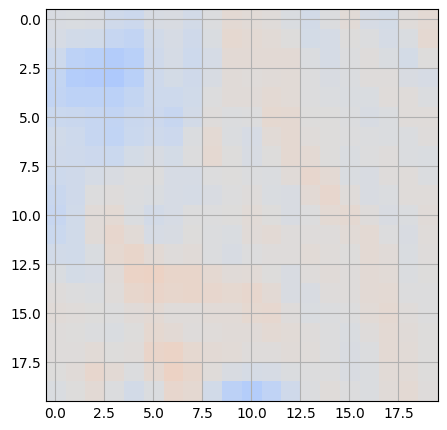

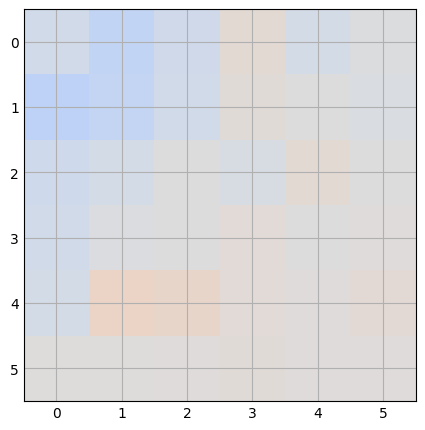

In [ ]:
# # Select an averaging region
# Omega_avg_coarse = [[i for i in range(14,34)], [j for j in range(36,56)]] # On coarsened grid
# Omega_avg_fine = [[i for i in range(14*3,34*3)], [j for j in range(36*3,56*3)]] # On fine grid

thyme = 0

plt.imshow(W[(138-21//2):(138+21//2), (72-21//2):(72+21//2), n0+thyme], cmap='coolwarm', vmin=-30, vmax=30)
plt.show()

plt.imshow(soln[(46-7//2):(46+7//2), (24-7//2):(24+7//2), 0+thyme], cmap='coolwarm', vmin=-30, vmax=30)
plt.show()

In [ ]:
soln.shape, soln.reshape((86**2,-1)).shape

((86, 86, 79), (7396, 79))

In [ ]:
solnavg = soln[(46-7//2):(46+7//2), (24-7//2):(24+7//2), :].reshape((6**2,-1))
print(solnavg.shape)
solnavg = solnavg.mean(0)
solnavg.shape

(36, 79)


(79,)

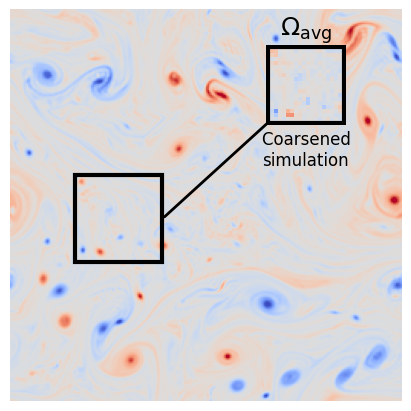

In [ ]:
import matplotlib.patches as patches

# Create the figure and main axis for the original data
plt.rcParams['figure.figsize'] = [4, 4]
fig, ax = plt.subplots()

# Plot the original data
im_main = ax.imshow(W[:,:,n0], cmap='coolwarm', vmin=-30, vmax=30)
ax.axis('off')

# Coordinates for the black box in the original plot
x_start = 14*3
x_end = 33*3
y_start = 36*3
y_end = 55*3
width = x_end - x_start
height = y_end - y_start

# Add a black box around the specified region in the original data
rect_main = patches.Rectangle(
    (x_start, y_start),  # (x, y) position of the rectangle's lower-left corner
    width,               # Width of the rectangle
    height,              # Height of the rectangle
    linewidth=3,         # Width of the rectangle's border line
    edgecolor='black',   # Color of the border line
    facecolor='none')   # No fill color
ax.add_patch(rect_main)

# Create an inset axis for the averaging region
# Adjust the [left, bottom, width, height] to position it in the top right corner
inset_ax = fig.add_axes([0.65, 0.7, 0.2, 0.2])  # Adjust these values as needed

# Plot the averaging region in the inset axis
im_inset = inset_ax.imshow(soln[36:56, 14:34, 0], cmap='coolwarm', vmin=-30, vmax=30)
inset_ax.set_title('$\Omega_{\\rm{avg}}$', fontsize=18)
inset_ax.axis('off')

# Add a red box around the inset plot
rect_inset = patches.Rectangle(
    (0, 0),  # (x, y) position of the rectangle's lower-left corner
    19,       # Width of the rectangle (normalized to inset axis size)
    19,       # Height of the rectangle (normalized to inset axis size)
    linewidth=3,  # Width of the rectangle's border line
    edgecolor='black',  # Color of the border line
    facecolor='none')  # No fill color
inset_ax.add_patch(rect_inset)

# Coordinates for the line connection points
main_x = x_end
main_y = y_start + height / 2
inset_x = 0.15  # Start at the left of the inset
inset_y = 0.15  # Middle of the inset vertically

# Transform inset coordinates to figure coordinates
inset_coords = inset_ax.transAxes.transform((inset_x, inset_y))
inset_coords = fig.transFigure.inverted().transform(inset_coords)

# Draw a line connecting the two boxes using ax.annotate
ax.annotate('',
            xy=(main_x, main_y), xycoords='data',
            xytext=inset_coords, textcoords='figure fraction',
            arrowprops=dict(arrowstyle="-", color='black', linewidth=2))

# Add text annotation near the line using ax.text
ax.text(main_x+65, main_y-35, 'Coarsened \nsimulation', fontsize=12, color='black')
plt.show()

In [ ]:
solution.t.shape, t[n0:].shape

((79,), (80,))

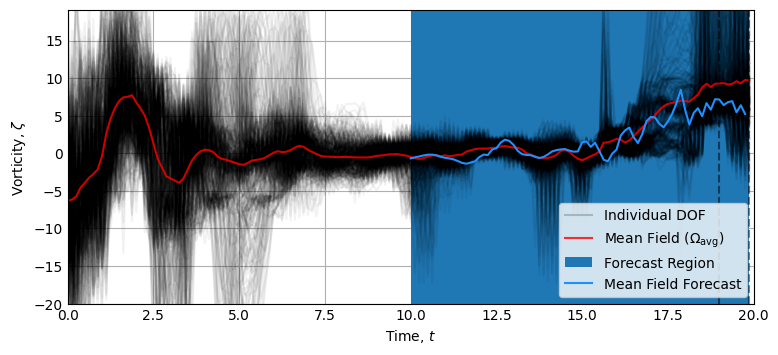

In [ ]:
# Spatial average (original data)
#Wavg = W[(138-21):(138+21), (72-21):(72+21), :].reshape((-1,160))
Wavg = W[(138-21//2):(138+21//2), (72-21//2):(72+21//2), :].reshape((-1,160))
Wavg = Wavg.mean(0)

plt.rcParams['figure.figsize'] = [7, 3]
fig,ax = plt.subplots(gridspec_kw={'wspace':0.1,'hspace':0.3})

# Plot chaotic time series and nearby points
# (138.0, 72.0) is roughly the center index
for i in range(-21//2, 21//2):
  for j in range(-21//2, 21//2):
    if (i==0) & (j==0):
      ax.plot(t,W[138+i,73+j,:], color='black', alpha=0.2, label='Individual DOF')
    else:
      ax.plot(t,W[138+i,73+j,:], color='black', alpha=0.05)
ax.plot(t,Wavg, color='red', label='Mean Field ($\Omega_{\\rm{avg}}$)', alpha=0.8)
ax.axvline(x=19, ls='--', color='black', alpha=0.5)
ax.axvline(x=(T-dt), ls='--', color='black', alpha=0.5)
ax.fill_between(t[n0:],-30, 30, label='Forecast Region')
ax.plot(t[n0:-1],solnavg, color='dodgerblue', label='Mean Field Forecast')
ax.set_xlim([0,20])
ax.set_ylim([-20,Wavg.mean(0)+5*Wavg.std(0)])
ax.legend(loc='lower right')
ax.set_xlabel('Time, $t$')
ax.set_ylabel('Vorticity, $\zeta$')
plt.show()

In [ ]:
# LYAPUNOV EXPONENTS
import nolds

# Nolds parameters
lyap_e_args = dict(min_tsep=5, emb_dim=41, matrix_dim=3, tau=dt, min_nb=6)

# For DOF in vorticity field
LE = max(nolds.lyap_e(W[138,73,:].numpy(), **lyap_e_args))
print(LE)

In [ ]:
nolds.lyap_e(W[138,73,:].numpy(), **lyap_e_args)